<a href="https://colab.research.google.com/github/JasonGross/neural-net-coq-interp/blob/main/October_2023_Monthly_Algorithmic_Challenge_Sorted_List_Jason%2C_Thomas%2C_Rajashree.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Monthly Algorithmic Challenge (October 2023): Sorted List

This post is the fourth in the sequence of monthly mechanistic interpretability challenges. They are designed in the spirit of [Stephen Casper's challenges](https://www.lesswrong.com/posts/KSHqLzQscwJnv44T8/eis-vii-a-challenge-for-mechanists), but with the more specific aim of working well in the context of the rest of the ARENA material, and helping people put into practice all the things they've learned so far.


If you prefer, you can access the Streamlit page [here](https://arena-ch1-transformers.streamlit.app/Monthly_Algorithmic_Problems).

<img src="https://raw.githubusercontent.com/callummcdougall/computational-thread-art/master/example_images/misc/sorted-problem.png" width="350">

## Setup

In [7]:
try:
    import google.colab # type: ignore
    IN_COLAB = True
except:
    IN_COLAB = False

import os; os.environ["ACCELERATE_DISABLE_RICH"] = "1"
import sys

if IN_COLAB:
    # Install packages
    %pip install einops
    %pip install jaxtyping
    %pip install transformer_lens
    %pip install git+https://github.com/callummcdougall/eindex.git
    %pip install git+https://github.com/callummcdougall/CircuitsVis.git#subdirectory=python

    # Code to download the necessary files (e.g. solutions, test funcs)
    import os, sys
    if not os.path.exists("chapter1_transformers"):
        !curl -o /content/main.zip https://codeload.github.com/callummcdougall/ARENA_2.0/zip/refs/heads/main
        !unzip /content/main.zip 'ARENA_2.0-main/chapter1_transformers/exercises/*'
        sys.path.append("/content/ARENA_2.0-main/chapter1_transformers/exercises")
        os.remove("/content/main.zip")
        os.rename("ARENA_2.0-main/chapter1_transformers", "chapter1_transformers")
        os.rmdir("ARENA_2.0-main")
        os.chdir("chapter1_transformers/exercises")
else:
    from IPython import get_ipython
    ipython = get_ipython()
    ipython.run_line_magic("load_ext", "autoreload")
    ipython.run_line_magic("autoreload", "2")
    import os, sys
    if not os.path.exists("chapter1_transformers"):
        !curl -o main.zip https://codeload.github.com/callummcdougall/ARENA_2.0/zip/refs/heads/main
        !unzip main.zip 'ARENA_2.0-main/chapter1_transformers/exercises/*'
        os.remove("main.zip")
        os.rename("ARENA_2.0-main/chapter1_transformers", "chapter1_transformers")
        sys.path.append(f"{os.getcwd()}/chapter1_transformers/exercises")
        os.rmdir("ARENA_2.0-main")

In [8]:
import torch as t
from pathlib import Path

# Make sure exercises are in the path
chapter = r"chapter1_transformers"
exercises_dir = Path(f"{os.getcwd().split(chapter)[0]}/{chapter}/exercises").resolve()
section_dir = exercises_dir / "monthly_algorithmic_problems" / "october23_sorted_list"
if str(exercises_dir) not in sys.path: sys.path.append(str(exercises_dir))

from monthly_algorithmic_problems.october23_sorted_list.dataset import SortedListDataset
from monthly_algorithmic_problems.october23_sorted_list.model import create_model
from plotly_utils import hist, bar, imshow

device = t.device("cuda" if t.cuda.is_available() else "cpu")



## Prerequisites

The following ARENA material should be considered essential:

* **[1.1] Transformer from scratch** (sections 1-3)
* **[1.2] Intro to Mech Interp** (sections 1-3)

The following material isn't essential, but is recommended:

* **[1.2] Intro to Mech Interp** (section 4)
* **[1.4] Balanced Bracket Classifier** (all sections)
* Previous algorithmic problems in the sequence


## Difficulty

**This problem is probably the easiest in the sequence so far**, so I expect solutions to have fully reverse-engineered it, as well as presenting adversarial examples and explaining how & why they work.**


## Motivation

Neel Nanda's post [200 COP in MI: Interpreting Algorithmic Problems](https://www.lesswrong.com/posts/ejtFsvyhRkMofKAFy/200-cop-in-mi-interpreting-algorithmic-problems) does a good job explaining the motivation behind solving algorithmic problems such as these. I'd strongly recommend reading the whole post, because it also gives some high-level advice for approaching such problems.

The main purpose of these challenges isn't to break new ground in mech interp, rather they're designed to help you practice using & develop better understanding for standard MI tools (e.g. interpreting attention, direct logit attribution), and more generally working with libraries like TransformerLens.

Also, they're hopefully pretty fun, because why shouldn't we have some fun while we're learning?

## Logistics

The solution to this problem will be published on this page at the start of November, at the same time as the next problem in the sequence. There will also be an associated LessWrong post.

If you try to interpret this model, you can send your attempt in any of the following formats:

* Colab notebook,
* GitHub repo (e.g. with ipynb or markdown file explaining results),
* Google Doc (with screenshots and explanations),
* or any other sensible format.

You can send your attempt to me (Callum McDougall) via any of the following methods:

* The [Slack group](https://join.slack.com/t/arena-la82367/shared_invite/zt-1uvoagohe-JUv9xB7Vr143pdx1UBPrzQ), via a direct message to me
* My personal email: `cal.s.mcdougall@gmail.com`
* LessWrong message ([here](https://www.lesswrong.com/users/themcdouglas) is my user)

**I'll feature the names of everyone who sends me a solution on this website, and also give a shout out to the best solutions.** It's possible that future challenges will also feature a monetary prize, but this is not guaranteed.

Please don't discuss specific things you've found about this model until the challenge is over (although you can discuss general strategies and techniques, and you're also welcome to work in a group if you'd like). The deadline for this problem will be the end of this month, i.e. 31st August.

## What counts as a solution?

Going through the solutions for the previous problem in the sequence (July: Palindromes) as well as the exercises in **[1.4] Balanced Bracket Classifier** should give you a good idea of what I'm looking for. In particular, I'd expect you to:

* Describe a mechanism for how the model solves the task, in the form of the QK and OV circuits of various attention heads (and possibly any other mechanisms the model uses, e.g. the direct path, or nonlinear effects from layernorm),
* Provide evidence for your mechanism, e.g. with tools like attention plots, targeted ablation / patching, or direct logit attribution.
* (Optional) Include additional detail, e.g. identifying the subspaces that the model uses for certain forms of information transmission, or using your understanding of the model's behaviour to construct adversarial examples.

## Task & Dataset

The problem for this month is interpreting a model which has been trained to sort a list. The model is fed sequences like:

```
[11, 2, 5, 0, 3, 9, SEP, 0, 2, 3, 5, 9, 11]
```

and has been trained to predict each element in the sorted list (in other words, the output at the `SEP` token should be a prediction of `0`, the output at `0` should be a prediction of `2`, etc).

Here is an example of what this dataset looks like:

In [9]:
dataset = SortedListDataset(size=1, list_len=5, max_value=10, seed=42)

print(dataset[0].tolist())
print(dataset.str_toks[0])

[9, 6, 2, 4, 5, 11, 2, 4, 5, 6, 9]
['9', '6', '2', '4', '5', 'SEP', '2', '4', '5', '6', '9']


The relevant files can be found at:

```
chapter1_transformers/
└── exercises/
    └── monthly_algorithmic_problems/
        └── october23_sorted_list/
            ├── model.py               # code to create the model
            ├── dataset.py             # code to define the dataset
            ├── training.py            # code to training the model
            └── training_model.ipynb   # actual training script
```


## Model

The model is attention-only, with 1 layer, and 2 attention heads per layer. It was trained with layernorm, weight decay, and an Adam optimizer with linearly decaying learning rate.

You can load the model in as follows:


In [10]:
filename = section_dir / "sorted_list_model.pt"

model = create_model(
    list_len=10,
    max_value=50,
    seed=0,
    d_model=96,
    d_head=48,
    n_layers=1,
    n_heads=2,
    normalization_type="LN",
    d_mlp=None
)

state_dict = t.load(filename)

state_dict = model.center_writing_weights(t.load(filename))
state_dict = model.center_unembed(state_dict)
state_dict = model.fold_layer_norm(state_dict)
state_dict = model.fold_value_biases(state_dict)
model.load_state_dict(state_dict, strict=False);

The code to process the state dictionary is a bit messy, but it's necessary to make sure the model is easy to work with. For instance, if you inspect the model's parameters, you'll see that `model.ln_final.w` is a vector of 1s, and `model.ln_final.b` is a vector of 0s (because the weight and bias have been folded into the unembedding).

In [11]:
print("ln_final weight: ", model.ln_final.w)
print("\nln_final, bias: ", model.ln_final.b)

ln_final weight:  Parameter containing:
tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1.], device='cuda:0', requires_grad=True)

ln_final, bias:  Parameter containing:
tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0', requires_

<details>
<summary>Aside - the other weight processing parameters</summary>

Here's some more code to verify that our weights processing worked, in other words:

* The unembedding matrix has mean zero over both its input dimension (`d_model`) and output dimension (`d_vocab`)
* All writing weights (i.e. `b_O`, `W_O`, and both embeddings) have mean zero over their output dimension (`d_model`)
* The value biases `b_V` are zero (because these can just be folded into the output biases `b_O`)

```python
W_U_mean_over_input = einops.reduce(model.W_U, "d_model d_vocab -> d_model", "mean")
t.testing.assert_close(W_U_mean_over_input, t.zeros_like(W_U_mean_over_input))

W_U_mean_over_output = einops.reduce(model.W_U, "d_model d_vocab -> d_vocab", "mean")
t.testing.assert_close(W_U_mean_over_output, t.zeros_like(W_U_mean_over_output))

W_O_mean_over_output = einops.reduce(model.W_O, "layer head d_head d_model -> layer head d_head", "mean")
t.testing.assert_close(W_O_mean_over_output, t.zeros_like(W_O_mean_over_output))

b_O_mean_over_output = einops.reduce(model.b_O, "layer d_model -> layer", "mean")
t.testing.assert_close(b_O_mean_over_output, t.zeros_like(b_O_mean_over_output))

W_E_mean_over_output = einops.reduce(model.W_E, "token d_model -> token", "mean")
t.testing.assert_close(W_E_mean_over_output, t.zeros_like(W_E_mean_over_output))

W_pos_mean_over_output = einops.reduce(model.W_pos, "position d_model -> position", "mean")
t.testing.assert_close(W_pos_mean_over_output, t.zeros_like(W_pos_mean_over_output))

b_V = model.b_V
t.testing.assert_close(b_V, t.zeros_like(b_V))
```

</details>


A demonstration of the model working:


In [12]:
from eindex import eindex

N = 500
dataset = SortedListDataset(size=N, list_len=10, max_value=50, seed=43)

logits, cache = model.run_with_cache(dataset.toks)
logits: t.Tensor = logits[:, dataset.list_len:-1, :]

targets = dataset.toks[:, dataset.list_len+1:]

logprobs = logits.log_softmax(-1) # [batch seq_len vocab_out]
probs = logprobs.softmax(-1)

batch_size, seq_len = dataset.toks.shape
logprobs_correct = eindex(logprobs, targets, "batch seq [batch seq]")
probs_correct = eindex(probs, targets, "batch seq [batch seq]")

avg_cross_entropy_loss = -logprobs_correct.mean().item()

print(f"Average cross entropy loss: {avg_cross_entropy_loss:.3f}")
print(f"Mean probability on correct label: {probs_correct.mean():.3f}")
print(f"Median probability on correct label: {probs_correct.median():.3f}")
print(f"Min probability on correct label: {probs_correct.min():.3f}")

Average cross entropy loss: 0.039
Mean probability on correct label: 0.966
Median probability on correct label: 0.981
Min probability on correct label: 0.001


And a visualisation of its probability output for a single sequence:

In [13]:
def show(i):

    imshow(
        probs[i].T,
        y=dataset.vocab,
        x=[f"{dataset.str_toks[i][j]}<br><sub>({j})</sub>" for j in range(dataset.list_len+1, dataset.seq_len)],
        labels={"x": "Token", "y": "Vocab"},
        xaxis_tickangle=0,
        title=f"Sample model probabilities:<br>Unsorted = ({','.join(dataset.str_toks[i][:dataset.list_len])})",
        text=[
            ["〇" if (str_tok == target) else "" for target in dataset.str_toks[i][dataset.list_len+1: dataset.seq_len]]
            for str_tok in dataset.vocab
        ],
        width=400,
        height=1000,
    )

show(0)

Best of luck! 🎈

The algorithm the transformer seems to run is roughly:
**Find the smallest value not smaller than the current token, which hasn't been "cancelled" by an equivalent copy appearing already in the sorted list**

Head 0 is mostly doing the cancelling, while head 1 is mostly doing the copying, except for token values around 28--37 where head 0 is doing copying and head 1 is doing nothing.

Additional notes:
- The skip connection (embed -> unembed) is a small bias against the current token, a smaller bias against numbers less than the current token, and a smaller bias in favor of numbers greater than the current token.
- The layernorm scaling is fairly uniform at positions on the unsorted list but a bit less uniform on the sorted prefix (after the SEP token)
- It seems like the cancelling doesn't work that well when there are tokens in the range where the head behavior is swapped, so most of the computation should work even in the absence of cancelling.  The cancelling presumably just tips the scales in marginal cases (and cases where there are duplicates), since most of the head's capacity is devoted to positive copying when such tokens are present.

To validate this hypothesis, we need to establish a couple of assertions:

Let $S$ be the range of swapped tokens, $S = [28, 29, 30, 31, 32, 33, 34, 35, 36, 37]$.

Let $h_{k}$ denote head 0 for tokens $k \in S$ and head 1 otherwise.

1. When the query token is SEP in position 10, we find the minimum of the sequence
2. When the query token is 50 in position 19, we emit 50
3. When the query token is anything other than 50 in position 19, we emit the maximum of the sequence
4. When the query is in positions between 11 and 18 inclusive, we follow the rough algorithm above.

We can break down:
1. Breakdown:
   1. Attention by head $h_{k}$ is mostly monotonic decreasing in the value of the token $k$
   2. The OV circuit on head $h_{k}$ copies the value $k$ more than anything else
   3. We pay enough more attention to the smallest token than to everything else combined and copy $k$ enough more than anything else that when we combine the effects of the two heads on other tokens, we still manage to copy the correct token.
2. Breakdown:
   1. The copying effects from attending to 50 in position 19 and one additional 50 in some position before 10 gives enough difference between 50 and anything else that we don't care what happens elsewhere.
3. Breakdown (TODO: Check if this is right, it might not be)
   1. Attention by head $h_{k}$ in position 19 is mostly monotonic increasing in the value of the token $k$
   2. The OV circuit on head $h_{k}$ copies the value $k$ more than anything else
   3. We pay enough more attention to the largest token than to everything else combined and copy $k$ enough more than anything else that when we combine the effects of the two heads on other tokens, we still manage to copy the correct token.
4. Breakdown:
   1. For $k_1, k_2, q \not\in S$ with $k_1 < q \le k_2$, head 1 pays more attention to $k_2$ in positions before 10 than to $k_1$ in any position
   2. For $k_1, k_2, q \not\in S$ with $k_1 = q \le k_2$, head 1 pays more attention to $k_2$ in positions before 10 than to $k_1$ in positions after 10
   3. For $k_1, k_2, q \not\in S$ with $q \le k_1 < k_2$, head 1 pays more attention to $k_1$ in positions before 10 than to $k_2$ in positions before 10
   4. For $k_2 \in S$ with $k_1 < q \le k_2$, head 0 pays more attention to $k_2$ in positions before 10 than to $k_1$ in any position
   5. For $k_2 \in S$ with $k_1 = q \le k_2$, head 0 pays more attention to $k_2$ in positions before 10 than to $k_1$ in positions after 10
   6. For $k_1 \in S$ with $q \le k_1 < k_2$, head 0 pays more attention to $k_1$ in positions before 10 than to $k_2$ in positions before 10
   7. TODO more stuff

# Setup


## Imports

In [36]:
from einops import einsum, rearrange, reduce
import torch
from matplotlib.widgets import Slider
from matplotlib import colors
from tqdm.auto import tqdm
from matplotlib.animation import FuncAnimation
import circuitsvis as cv
import matplotlib.pyplot as plt
from IPython.display import display, HTML
import numpy as np
import transformer_lens.utils as utils
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Utils

In [30]:
def imshow(tensor, renderer=None, xaxis="", yaxis="", **kwargs):
    px.imshow(utils.to_numpy(tensor), color_continuous_midpoint=0.0, color_continuous_scale="RdBu", labels={"x":xaxis, "y":yaxis}, **kwargs).show(renderer)


def line(tensor, renderer=None, xaxis="", yaxis="", line_labels=None, **kwargs):
    px.line(utils.to_numpy(tensor), labels={"x":xaxis, "y":yaxis}, y=line_labels, **kwargs).show(renderer)


def scatter(x, y, xaxis="", yaxis="", caxis="", renderer=None, **kwargs):
    x = utils.to_numpy(x)
    y = utils.to_numpy(y)
    px.scatter(y=y, x=x, labels={"x":xaxis, "y":yaxis, "color":caxis}, **kwargs).show(renderer)


def hist(tensor, renderer=None, xaxis="", yaxis="", **kwargs):
    px.histogram(utils.to_numpy(tensor), labels={"x":xaxis, "y":yaxis}, **kwargs).show(renderer)


# Computation of Matrices (used in both visualization and as a cached computation in proofs)

In [35]:
@torch.no_grad()
def compute_attn_all(model, outdim='h qpos kpos qtok ktok'):
    resid = model.blocks[0].ln1(model.W_pos[:,None,:] + model.W_E[None,:,:])
    outdimsorted = [i for i in sorted(outdim.split(' ')) if i != '']
    assert outdimsorted == list(sorted(['h', 'qpos', 'kpos', 'qtok', 'ktok'])), f"outdim must be 'h qpos kpos qtok ktok' in some order, got {outdim}"
    q_all = einsum(resid,
                   model.W_Q[0,:,:,:],
                   'qpos qtok d_model_q, h d_model_q d_head -> qpos qtok h d_head') + model.b_Q[0]
    k_all = einsum(resid,
                   model.W_K[0,:,:,:],
                   'kpos ktok d_model_k, h d_model_k d_head -> kpos ktok h d_head') + model.b_K[0]
    attn_all = einsum(q_all, k_all, f'qpos qtok h d_head, kpos ktok h d_head -> {outdim}')
    attn_all_max = reduce(attn_all, f"{outdim} -> {outdim.replace('kpos', '()').replace('ktok', '()')}", 'max')
    # print(attn_all_max.shape)
    # print(attn_all.shape)
    # #attn_all[:,dataset.list_len:-1,:,:-1,:]
    attn_all = attn_all - attn_all_max
    return attn_all

# Exploratory Plots

Before diving into the proof, we provide some plots that may help with understanding the above claims.  These are purely exploratory (aimed at hypothesis generation) and are not required for hypothesis validation.

## Initial Layernorm Scaling

In [15]:
@torch.no_grad()
def layernorm_noscale(x: torch.Tensor) -> torch.Tensor:
    return x - x.mean(axis=-1, keepdim=True)

@torch.no_grad()
def layernorm_scales(x: torch.Tensor, eps: float = 1e-5, recip: bool = True) -> torch.Tensor:
    x = layernorm_noscale(x)
    scale = (x.pow(2).mean(axis=-1, keepdim=True) + eps).sqrt()
    if recip: scale = 1 / scale
    return scale

In [28]:
s = layernorm_scales(model.W_pos[:,None,:] + model.W_E[None,:,:])[...,0]
# the only token in position 10 is SEP
s[dataset.list_len, :-1] = float('nan')
# SEP never occurs in positions other than 10
s[:dataset.list_len, -1:], s[dataset.list_len+1:, -1:] = float('nan'), float('nan')
# we don't actually care about the prediction in the last position
s = s[:-1, :]
smin = s[~s.isnan()].min()
s = s / smin
imshow(s, xaxis="Token Value", x=dataset.vocab, yaxis="Position", title=f"Layer Norm Scaling (multiplied by {smin:.3f})")

## Attention Plots

In [50]:
attn_all = compute_attn_all(model, outdim='h qpos kpos qtok ktok', nanseplocation=dataset.list_len)
fig = make_subplots(rows=1, cols=model.cfg.n_heads, subplot_titles=("Head 0", "Head 1"))
fig.update_layout(title="Attention from SEP to other tokens and positions")
all_tickvals_text = list(enumerate(dataset.vocab))
tickvals_indices = list(range(0, len(all_tickvals_text) - 2, 10)) + [len(all_tickvals_text) - 2, len(all_tickvals_text) - 1]
tickvals = [all_tickvals_text[i][0] for i in tickvals_indices]
tickvals_text = [all_tickvals_text[i][1] for i in tickvals_indices]
attn_subset = attn_all[:, dataset.list_len, :dataset.list_len+1, -1, :]
zmin, zmax = attn_subset[~attn_subset.isnan()].min().item(), attn_subset[~attn_subset.isnan()].max().item()
for h in range(model.cfg.n_heads):
    fig.add_trace(go.Heatmap(z=utils.to_numpy(attn_subset[h]), colorscale='Viridis', zmin=zmin, zmax=zmax), row=1, col=h+1)
    fig.update_xaxes(tickvals=tickvals, ticktext=tickvals_text, title_text="Key Token", row=1, col=h+1)
    fig.update_yaxes(title_text="Position of Key", row=1, col=h+1)
fig.show()

# imshow(attn_all[], cmap='viridis')

  0%|          | 0/9 [00:00<?, ?it/s]

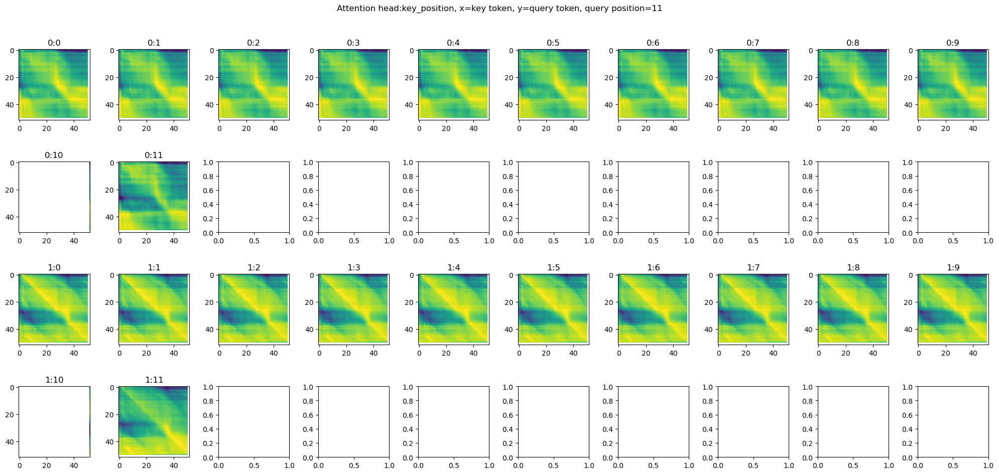

In [57]:
# Here you may want to determine an appropriate grid size based on the number of plots
# For example, if you have a total of 12 plots, you might choose a 3x4 grid
n_rows = 4  # Example value, adjust as needed
n_cols = dataset.list_len  # Example value, adjust as needed

# Create a figure and a grid of subplots
fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 10))
fig.suptitle(f"Attention from:to")
# Flatten the 2D axis array to easily iterate over it in a single loop
ax = ax.flatten()

attn_all = compute_attn_all(model, outdim='h qpos kpos qtok ktok')
# attention paid from the SEP position always has query = SEP
attn_all[:, dataset.list_len, :, :-1, :] = float('nan')
# attention paid to the SEP position is always to SEP
attn_all[:, :, dataset.list_len, :, :-1] = float('nan')
# attention paid from non-SEP positions never has query = SEP
attn_all[:, :dataset.list_len, :, -1, :], attn_all[:, dataset.list_len+1:, :, -1, :] = float('nan'), float('nan')
# attention paid to non-SEP positions never has key = SEP
attn_all[:, :, :dataset.list_len, :, -1], attn_all[:, :, dataset.list_len+1:, :, -1] = float('nan'), float('nan')
# self-attention always has query token = key token
# for h in range(attn_all.shape[0]):
#     for pos in range(attn_all.shape[1]):
#         for qtok in range(attn_all.shape[3]):
#             for ktok in range(attn_all.shape[4]):
#                 if qtok != ktok:
#                     attn_all[h, pos, pos, qtok, ktok] = float('nan')

default_attn = t.zeros_like(attn_all[0, 0, 0])
default_attn[:, :] = float('nan')
default_attn = default_attn.detach().cpu().numpy()
for r in range(n_rows):
    for c in range(n_cols):
        ax[r * n_rows + c].imshow(default_attn, cmap='viridis')
        ax[r * n_rows + c].set_title(f"")

def compute_attn_maps(qpos):
    attn_maps = []
    for kpos in range(qpos+1):
        for h in range(2):
            attn = attn_all[h, qpos, kpos, :, :]
            attn = attn.detach().cpu().numpy()

            attn_maps.append((h, kpos, attn))
    return attn_maps

def update(qpos):
    # Clear previous plots
    for a in ax:
        a.clear()

    attn_maps = compute_attn_maps(qpos)
    fig.suptitle(f"Attention head:key_position, x=key token, y=query token, query position={qpos}")

    for plot_idx, (h, kpos, attn) in enumerate(attn_maps):
        plot_idx = h * n_cols * 2 + kpos
            # break

        # Plot heatmap
        cax = ax[plot_idx].imshow(attn, cmap='viridis')

        # Set title and axis labels if desired
        ax[plot_idx].set_title(f"{h}:{kpos}")
        # ax[plot_idx].set_xlabel("key tok")
        # ax[plot_idx].set_ylabel("query tok")

        # Optionally add a colorbar
        # plt.colorbar(cax, ax=ax[plot_idx])

    plt.tight_layout()

# Create animation
ani = FuncAnimation(fig, update, frames=tqdm(range(dataset.list_len+1, dataset.seq_len-1)), interval=1000)
# ani = FuncAnimation(fig, update, frames=tqdm(range(dataset.list_len, dataset.list_len+2)))#, interval=1000)

# plt.show()
HTML(ani.to_jshtml())

# # Counter for the subplot index
# # plot_idx = 0

# for qpos in range(dataset.list_len, dataset.seq_len-1):
#     for kpos in range(qpos+1):
#         for h in range(2):
#             attn = model.blocks[0].ln1(model.W_pos[qpos,:] + model.W_E) @ model.W_Q[0,h,:,:] @ model.W_K[0,h,:,:].T @ model.blocks[0].ln1(model.W_pos[kpos,:] + model.W_E).T
#             attn = attn - attn.max(dim=-1, keepdim=True).values
#             attn = attn.detach().cpu().numpy()
#             # Check if the counter exceeds the available subplots and create new figure if needed
#             if plot_idx >= n_rows * n_cols:
#                 fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
#                 ax = ax.flatten()
#                 plot_idx = 0

#             # Plot heatmap
#             cax = ax[plot_idx].imshow(attn, cmap='viridis')

#             # Set title and axis labels if desired

#             ax[plot_idx].set_title(f"{h}: {qpos} -> {kpos}")
#             ax[plot_idx].set_xlabel("key tok")
#             ax[plot_idx].set_ylabel("query tok")

#             # Optionally add a colorbar
#             plt.colorbar(cax, ax=ax[plot_idx])

#             # Increment the counter
#             plot_idx += 1

#             # You might want to save or display the plot here if you're iterating over many subplots
#             if plot_idx == 0:
#                 plt.tight_layout()
#                 plt.show()

# Finding the Minimum with query SEP in Position 10

## Exploratory Plots

In [34]:
from training.analysis_utils import imshow, line, analyze_svd, layernorm_noscale, layernorm_scales

In [32]:
imshow(EPVOU)

In [11]:
attention_pattern = cache['blocks.0.attn.hook_pattern'].shape
cv.attention.attention_patterns(
    tokens=dataset.str_toks,
    attention=attention_pattern)

In [37]:
print(dataset.str_toks[0])
for p in cache['blocks.0.attn.hook_pattern'][0]:
    lbls = [f'{i}:{s}' for i, s in enumerate(dataset.str_toks[0])]
    imshow(p, x=lbls, y=lbls)

['7', '5', '47', '20', '48', '24', '11', '4', '19', '39', 'SEP', '4', '5', '7', '11', '19', '20', '24', '39', '47', '48']


In [25]:
cache.keys()

dict_keys(['hook_tokens', 'hook_embed', 'hook_pos_embed', 'blocks.0.hook_resid_pre', 'blocks.0.hook_q_input', 'blocks.0.hook_k_input', 'blocks.0.hook_v_input', 'blocks.0.ln1.hook_scale', 'blocks.0.ln1.hook_normalized', 'blocks.0.attn.hook_q', 'blocks.0.attn.hook_k', 'blocks.0.attn.hook_v', 'blocks.0.attn.hook_attn_scores', 'blocks.0.attn.hook_pattern', 'blocks.0.attn.hook_z', 'blocks.0.attn.hook_result', 'blocks.0.hook_attn_out', 'blocks.0.hook_resid_post', 'ln_final.hook_scale', 'ln_final.hook_normalized'])

In [23]:
model.blocks[0].ln1.b

Parameter containing:
tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0', requires_grad=True)

In [13]:
print(model.W_E.shape)

torch.Size([52, 96])


In [31]:
dataset[0]
model(t.tensor([10, 15, 30, 15, 15, 40, 41, 42, 43, 44, 51, 10, 15, 15, 15, 30, 40, 41, 42, 43, 44])).argmax(dim=-1)

tensor([[10, 15, 30, 15, 15, 40, 41, 41, 43, 43, 10, 15, 15, 15, 15, 40, 41, 42,
         43, 44,  0]], device='cuda:0')

In [15]:
dataset.list_len

10

In [16]:
dataset.seq_len

21

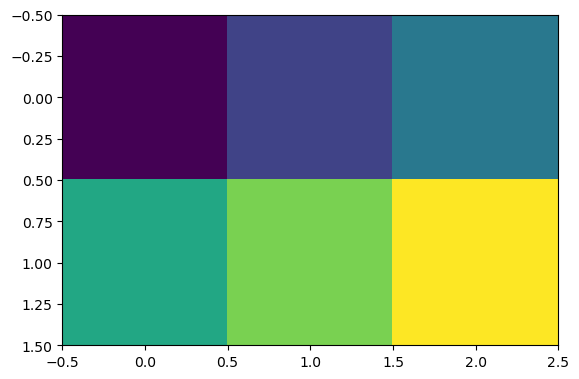

In [17]:
plt.imshow([[1,2,3],[4,5,6]])

In [18]:
model.W_E.shape

torch.Size([52, 96])

/tmp/ipykernel_1769634/326672972.py:25: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



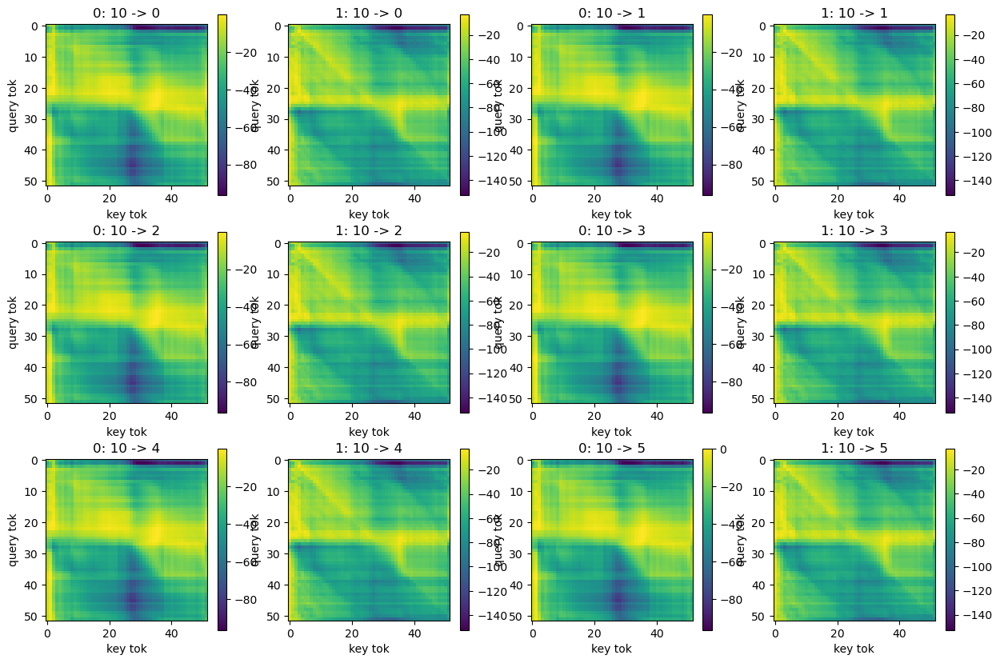

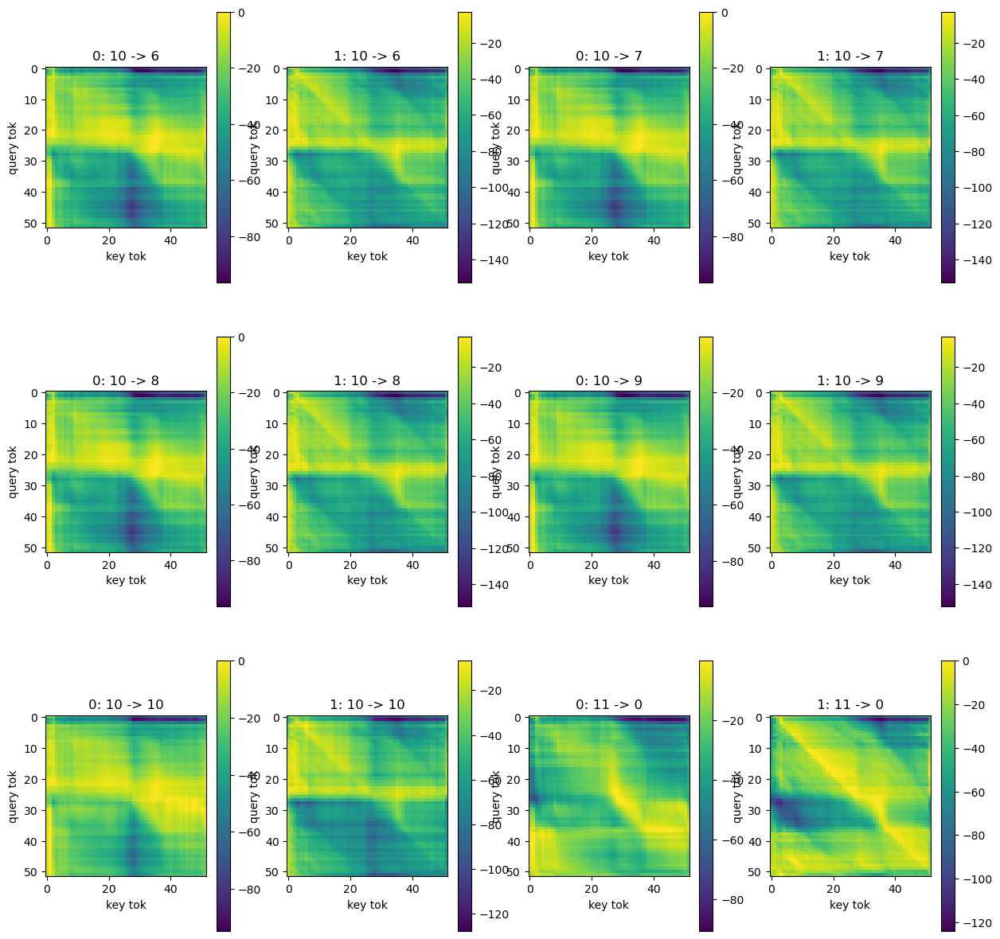

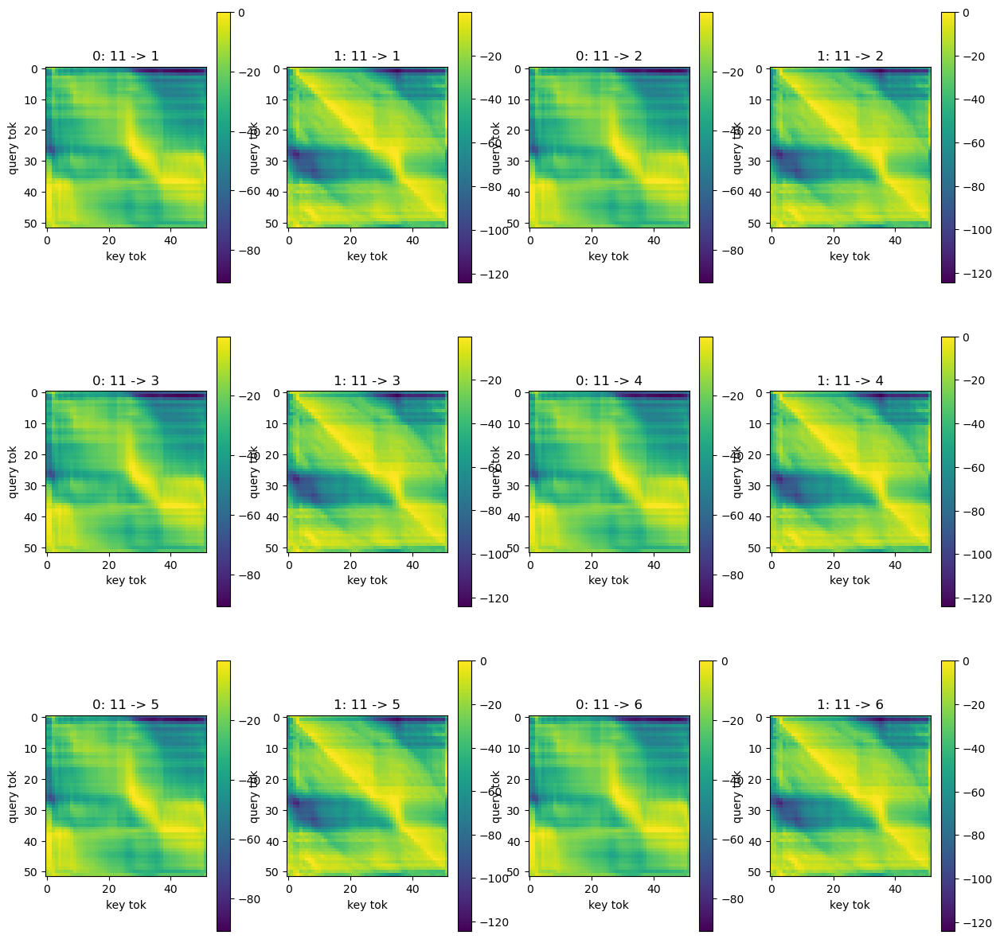

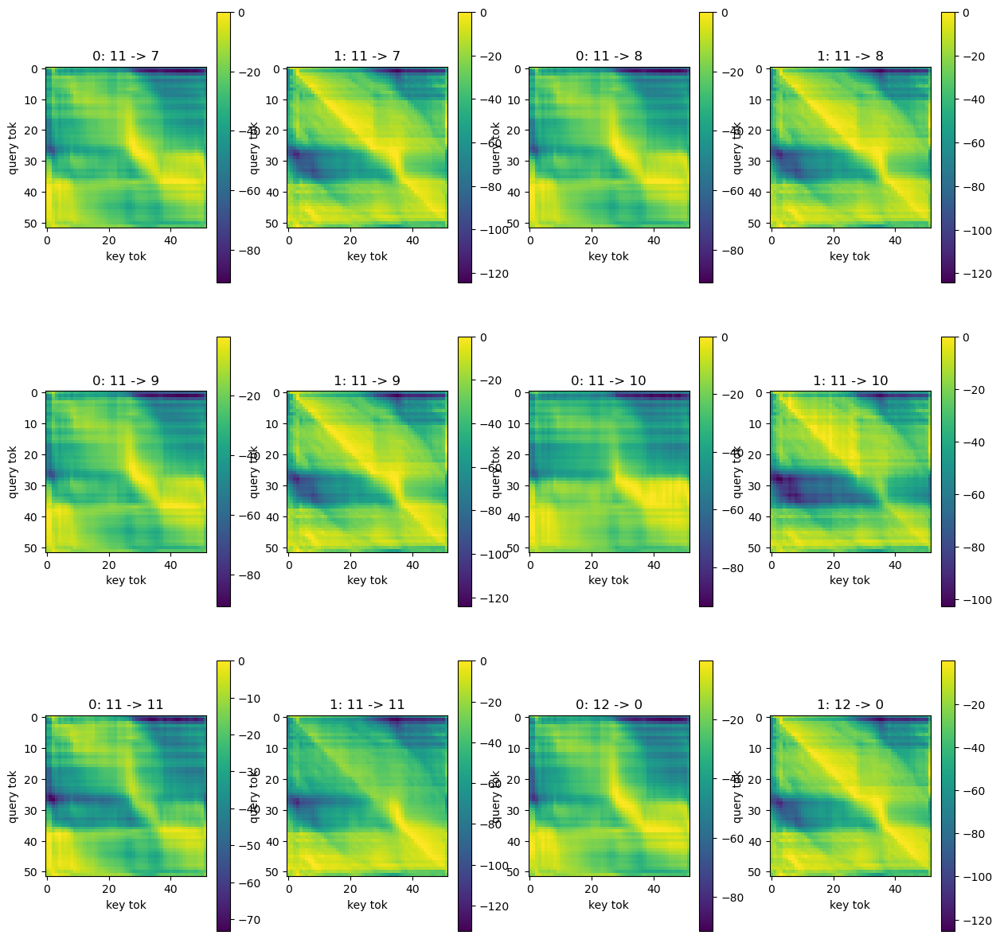

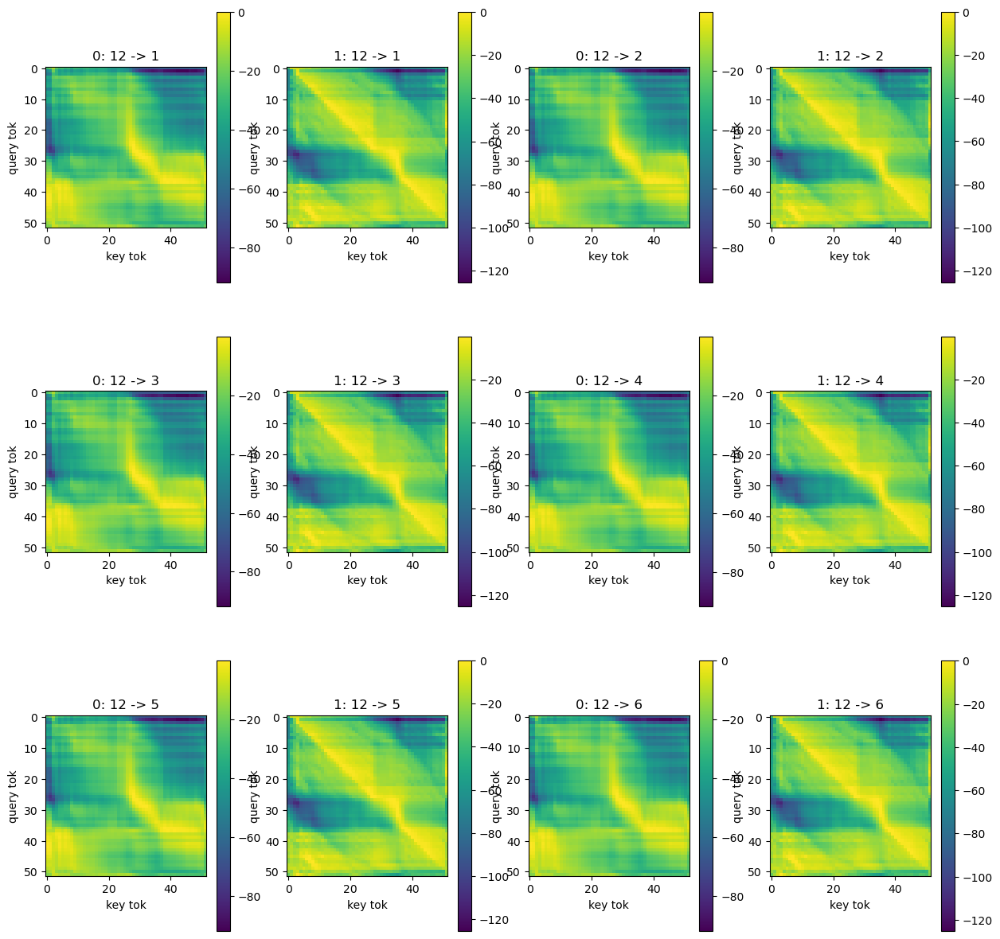

...

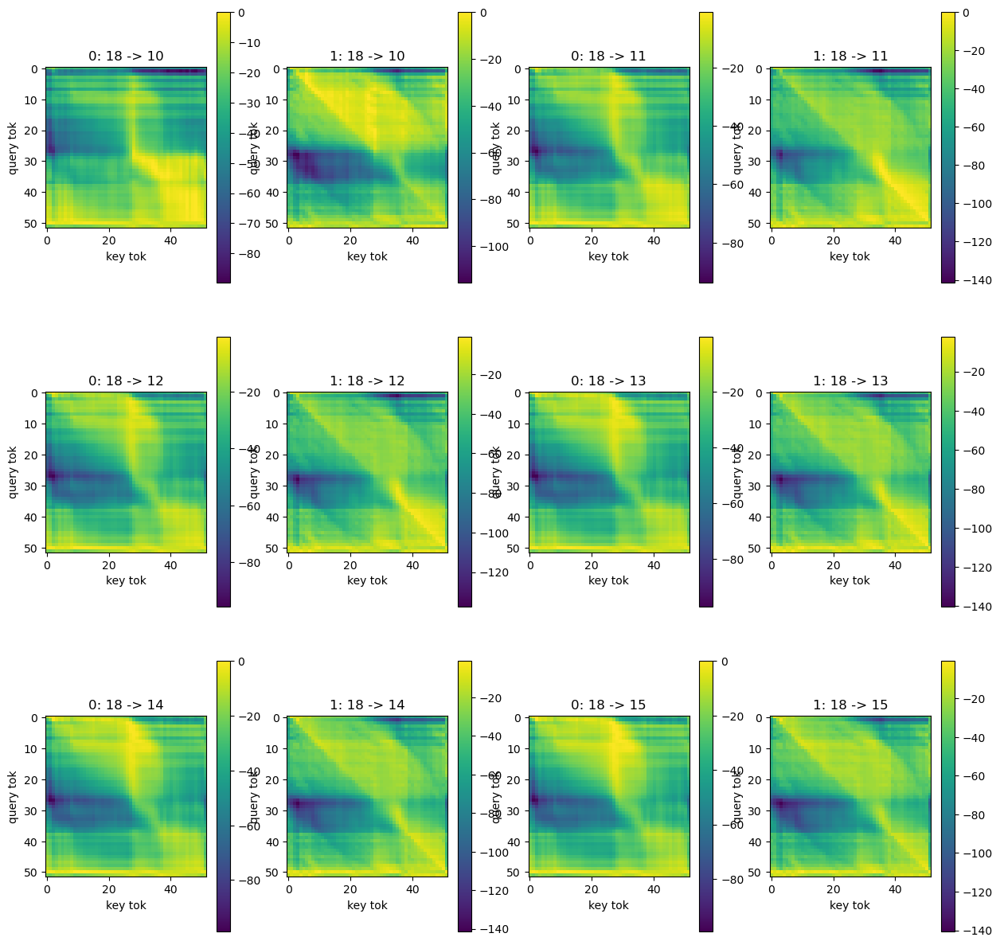

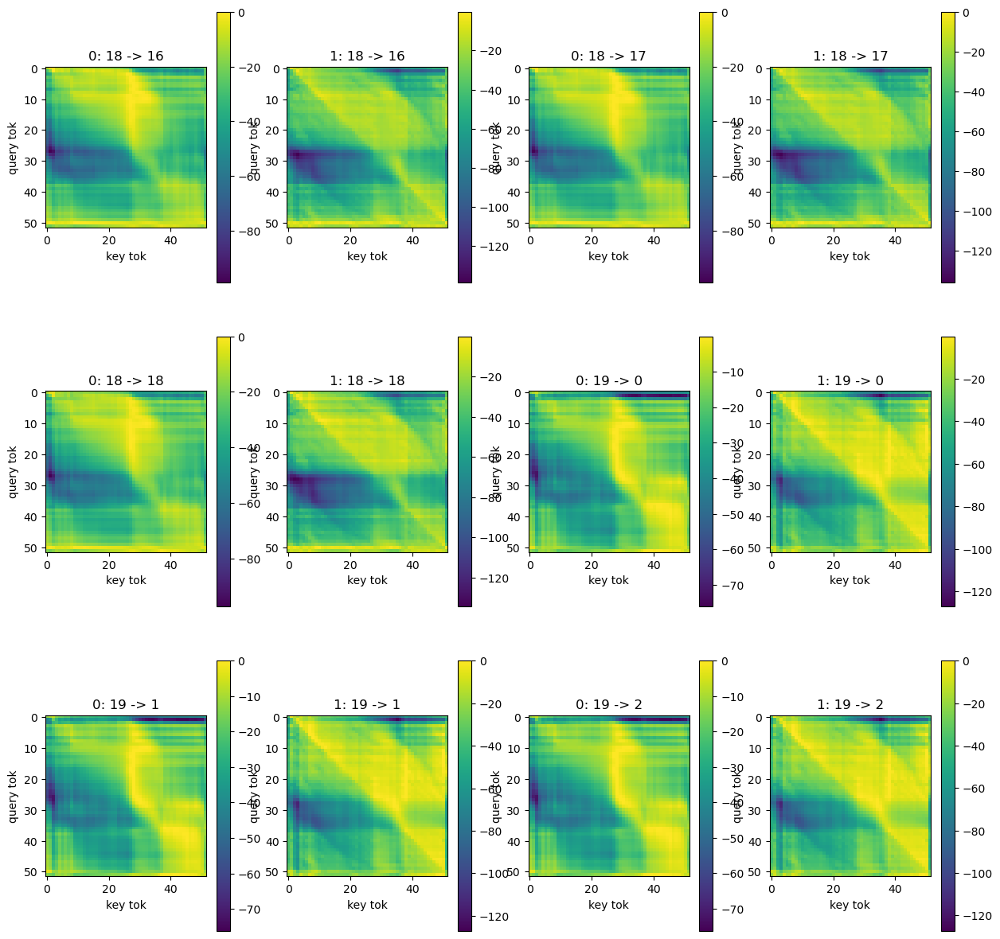

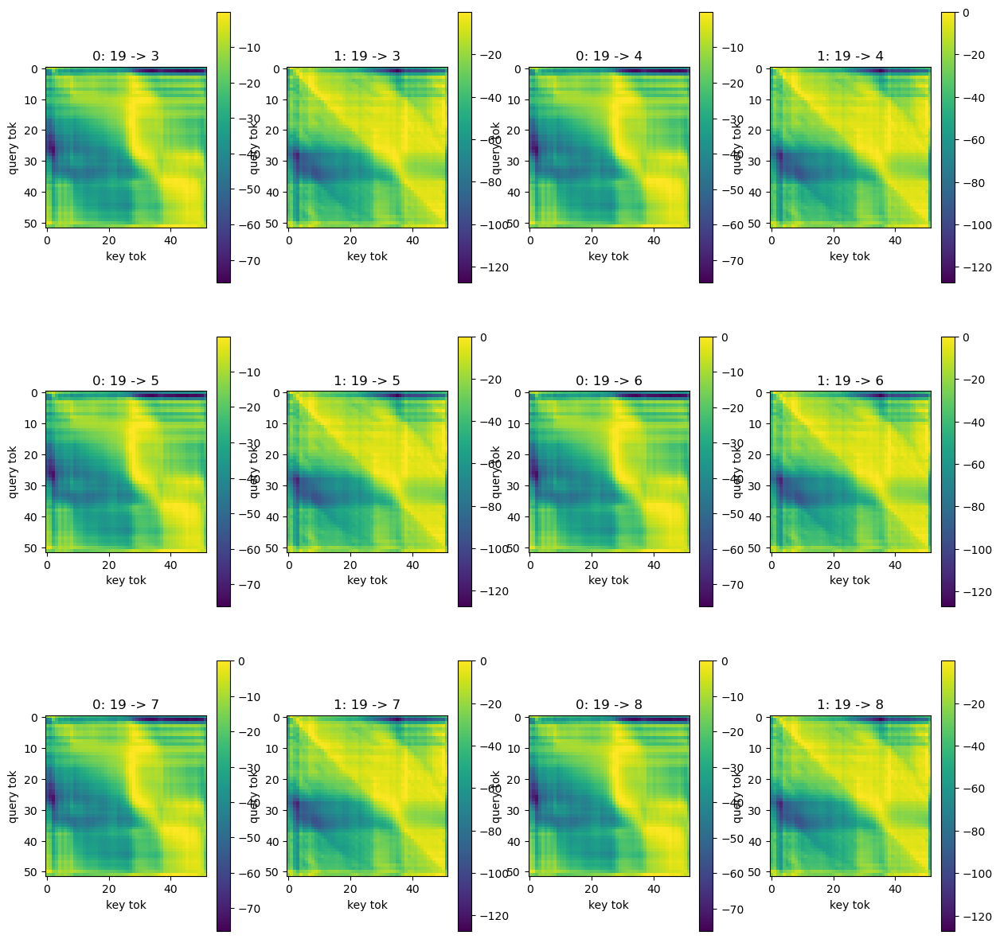

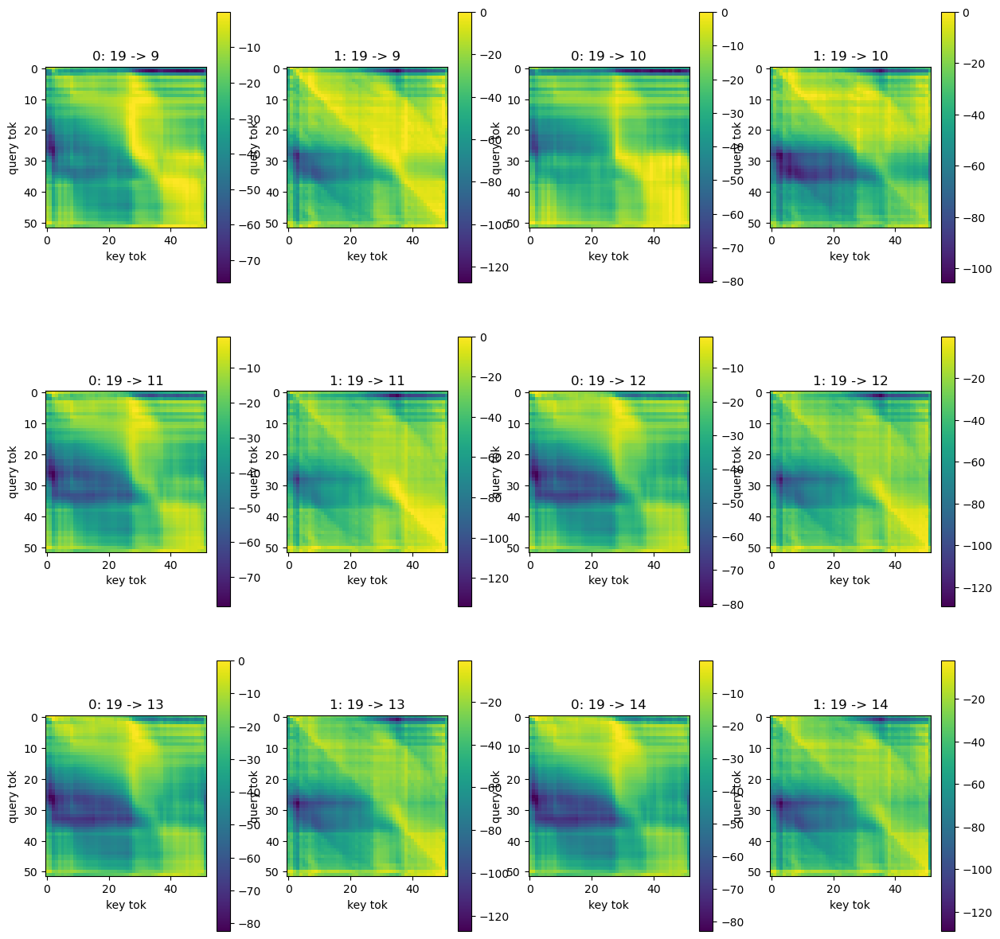

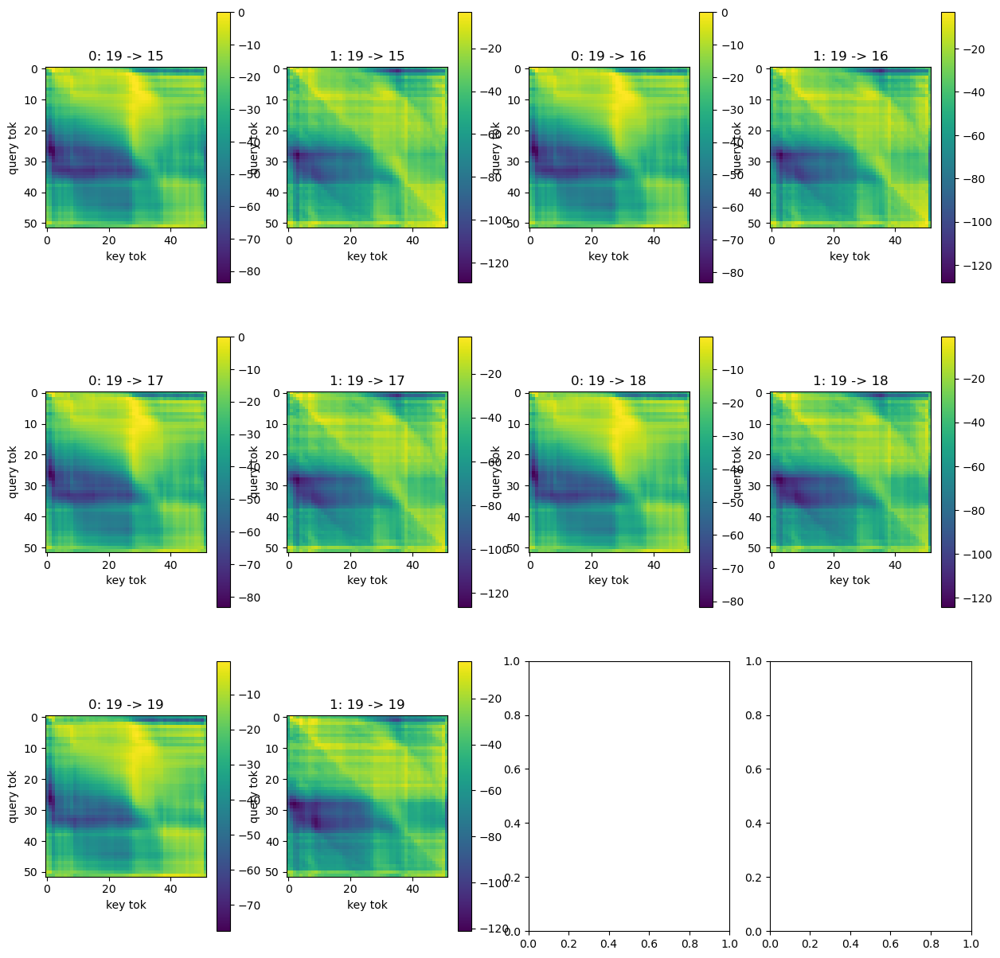

In [12]:
# Here you may want to determine an appropriate grid size based on the number of plots
# For example, if you have a total of 12 plots, you might choose a 3x4 grid
n_rows = 3  # Example value, adjust as needed
n_cols = 4  # Example value, adjust as needed

plot_idx = 0

# Create a figure and a grid of subplots
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 10))

# Flatten the 2D axis array to easily iterate over it in a single loop
ax = ax.flatten()


# Counter for the subplot index
# plot_idx = 0
attn_all = compute_attn_all(model, outdim='h qpos kpos qtok ktok')

for qpos in range(dataset.list_len, dataset.seq_len-1):
    for kpos in range(qpos+1):
        for h in range(2):
            attn = attn_all[h, qpos, kpos].detach().cpu().numpy()
            # Check if the counter exceeds the available subplots and create new figure if needed
            if plot_idx >= n_rows * n_cols:
                fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
                ax = ax.flatten()
                plot_idx = 0

            # Plot heatmap
            cax = ax[plot_idx].imshow(attn, cmap='viridis')

            # Set title and axis labels if desired

            ax[plot_idx].set_title(f"{h}: {qpos} -> {kpos}")
            ax[plot_idx].set_xlabel("key tok")
            ax[plot_idx].set_ylabel("query tok")

            # Optionally add a colorbar
            plt.colorbar(cax, ax=ax[plot_idx])

            # Increment the counter
            plot_idx += 1

            # You might want to save or display the plot here if you're iterating over many subplots
            if plot_idx == 0:
                plt.tight_layout()
                plt.show()

  0%|          | 0/10 [00:00<?, ?it/s]

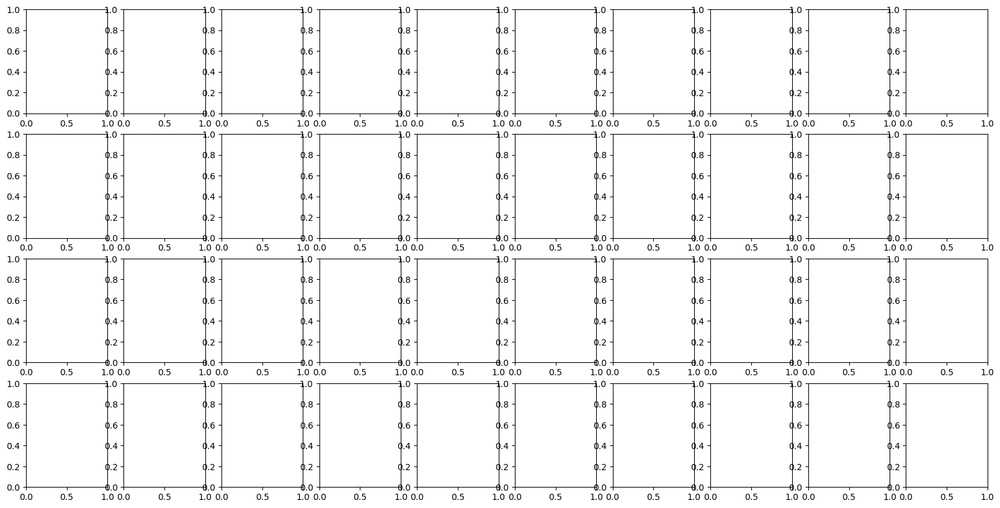

<Figure size 640x480 with 0 Axes>

In [13]:
# Here you may want to determine an appropriate grid size based on the number of plots
# For example, if you have a total of 12 plots, you might choose a 3x4 grid
n_rows = 4  # Example value, adjust as needed
n_cols = 10  # Example value, adjust as needed

# Create a figure and a grid of subplots
fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 10))

# Flatten the 2D axis array to easily iterate over it in a single loop
ax = ax.flatten()

attn_all = compute_attn_all(model, outdim='h qpos kpos qtok ktok')

def compute_attn_maps(qpos):
    attn_maps = []
    for kpos in range(qpos+1):
        for h in range(2):
            attn = attn_all[h, qpos, kpos, :, :]
            attn = attn.detach().cpu().numpy()

            attn_maps.append((h, kpos, attn))
    return attn_maps

def update(qpos):
    # Clear previous plots
    for a in ax:
        a.clear()

    attn_maps = compute_attn_maps(qpos)

    for plot_idx, (h, kpos, attn) in enumerate(attn_maps):
        plot_idx = h * n_cols * 2 + kpos
            # break

        # Plot heatmap
        cax = ax[plot_idx].imshow(attn, cmap='viridis')

        # Set title and axis labels if desired
        ax[plot_idx].set_title(f"{h}:{kpos}")
        # ax[plot_idx].set_xlabel("key tok")
        # ax[plot_idx].set_ylabel("query tok")

        # Optionally add a colorbar
        # plt.colorbar(cax, ax=ax[plot_idx])

    plt.tight_layout()

# Create animation
ani = FuncAnimation(fig, update, frames=tqdm(range(dataset.list_len, dataset.seq_len-1)), interval=1000)

plt.show()

from IPython.display import HTML
HTML(ani.to_jshtml())

# # Counter for the subplot index
# # plot_idx = 0

# for qpos in range(dataset.list_len, dataset.seq_len-1):
#     for kpos in range(qpos+1):
#         for h in range(2):
#             attn = model.blocks[0].ln1(model.W_pos[qpos,:] + model.W_E) @ model.W_Q[0,h,:,:] @ model.W_K[0,h,:,:].T @ model.blocks[0].ln1(model.W_pos[kpos,:] + model.W_E).T
#             attn = attn - attn.max(dim=-1, keepdim=True).values
#             attn = attn.detach().cpu().numpy()
#             # Check if the counter exceeds the available subplots and create new figure if needed
#             if plot_idx >= n_rows * n_cols:
#                 fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
#                 ax = ax.flatten()
#                 plot_idx = 0

#             # Plot heatmap
#             cax = ax[plot_idx].imshow(attn, cmap='viridis')

#             # Set title and axis labels if desired

#             ax[plot_idx].set_title(f"{h}: {qpos} -> {kpos}")
#             ax[plot_idx].set_xlabel("key tok")
#             ax[plot_idx].set_ylabel("query tok")

#             # Optionally add a colorbar
#             plt.colorbar(cax, ax=ax[plot_idx])

#             # Increment the counter
#             plot_idx += 1

#             # You might want to save or display the plot here if you're iterating over many subplots
#             if plot_idx == 0:
#                 plt.tight_layout()
#                 plt.show()

In [ ]:
model.ln_final

LayerNorm(
  (hook_scale): HookPoint()
  (hook_normalized): HookPoint()
)

In [10]:
def ln_final_noscale(x):
    return x - x.mean(axis=-1, keepdim=True)

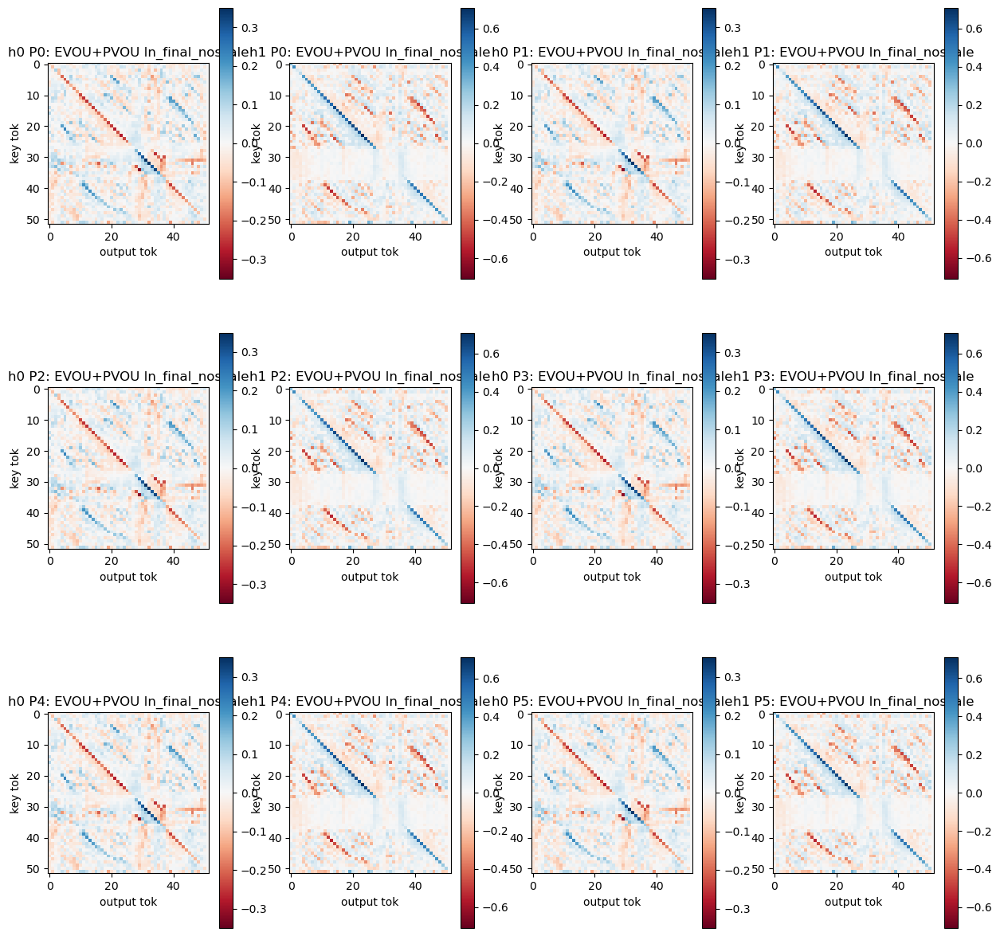

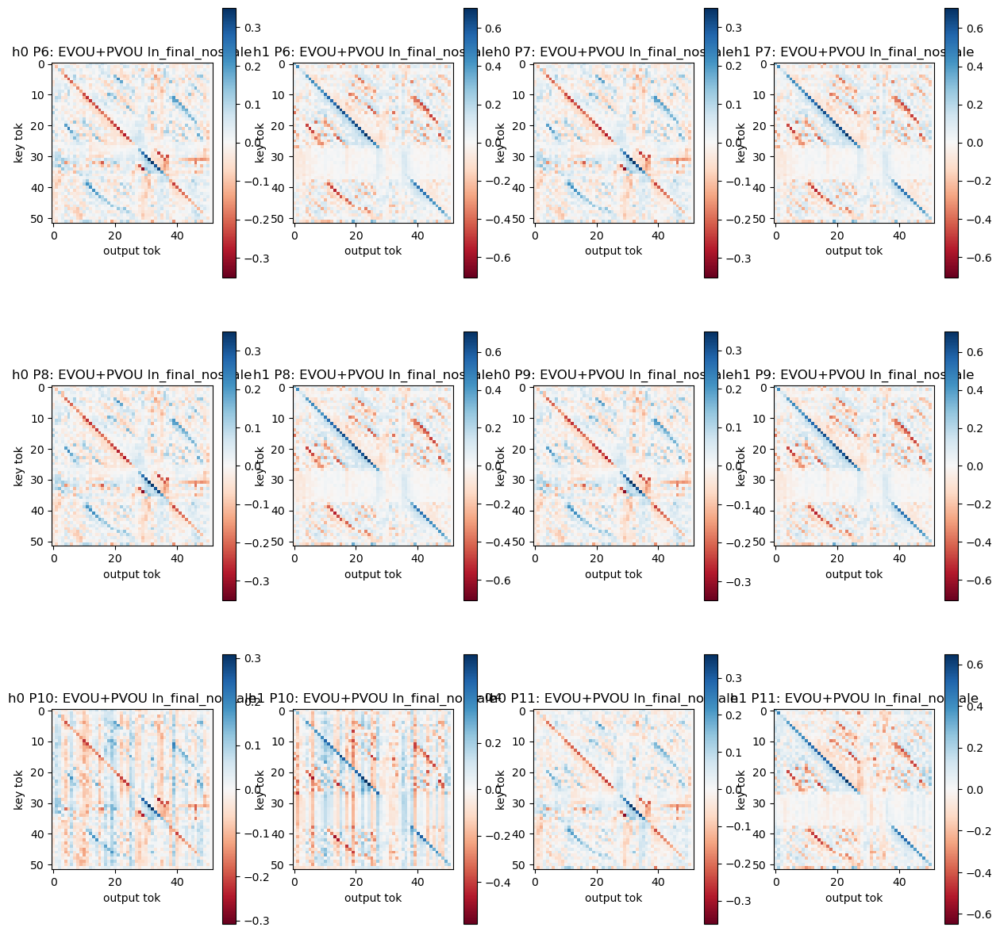

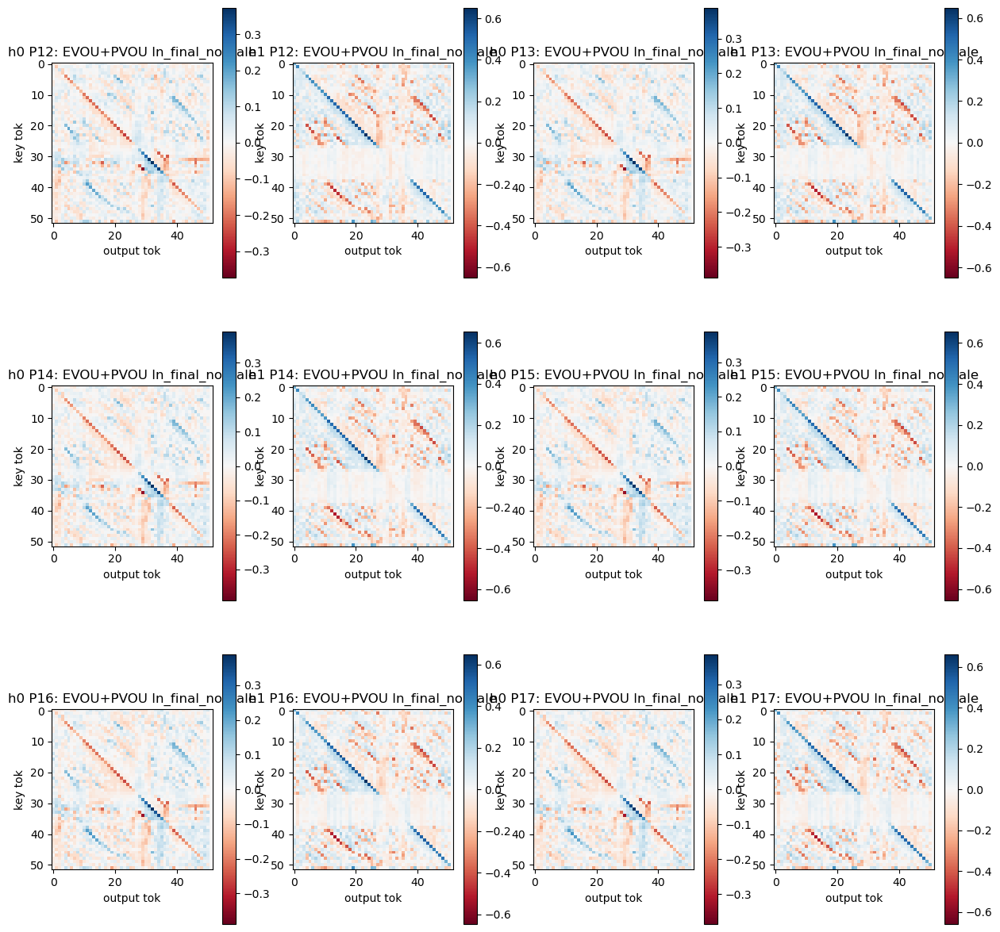

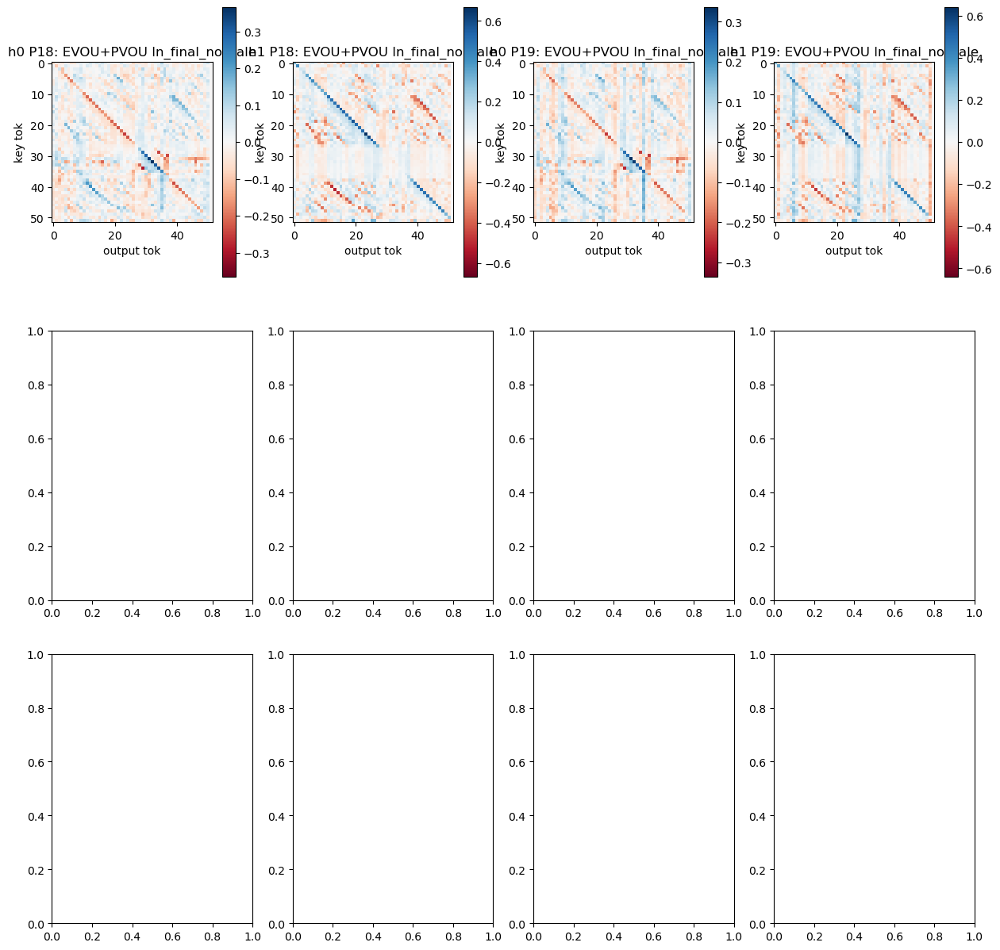

In [26]:
# Here you may want to determine an appropriate grid size based on the number of plots
# For example, if you have a total of 12 plots, you might choose a 3x4 grid
n_rows = 3  # Example value, adjust as needed
n_cols = 4  # Example value, adjust as needed

# Create a figure and a grid of subplots
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))

# Flatten the 2D axis array to easily iterate over it in a single loop
ax = ax.flatten()

# Counter for the subplot index
plot_idx = 0

for pos in range(dataset.seq_len-1):
    for h in range(2):
        EPVOU = ln_final_noscale(model.blocks[0].ln1(model.W_pos[pos,:] + model.W_E) @ model.W_V[0,h,:,:] @ model.W_O[0,h,:,:]) @ model.W_U
        EPVOU = EPVOU - EPVOU.mean(dim=-1, keepdim=True)
        EPVOU = EPVOU.detach().cpu().numpy()
        # Check if the counter exceeds the available subplots and create new figure if needed
        if plot_idx >= n_rows * n_cols:
            fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
            ax = ax.flatten()
            plot_idx = 0

        # Plot heatmap
        cax = ax[plot_idx].imshow(EPVOU, cmap='RdBu', norm=colors.CenteredNorm())

        # Set title and axis labels if desired

        ax[plot_idx].set_title(f"h{h} P{pos}: EVOU+PVOU ln_final_noscale")
        ax[plot_idx].set_xlabel("output tok")
        ax[plot_idx].set_ylabel("key tok")

        # Optionally add a colorbar
        plt.colorbar(cax, ax=ax[plot_idx])

        # Increment the counter
        plot_idx += 1

        # You might want to save or display the plot here if you're iterating over many subplots
        if plot_idx == 0:
            plt.tight_layout()
            plt.show()

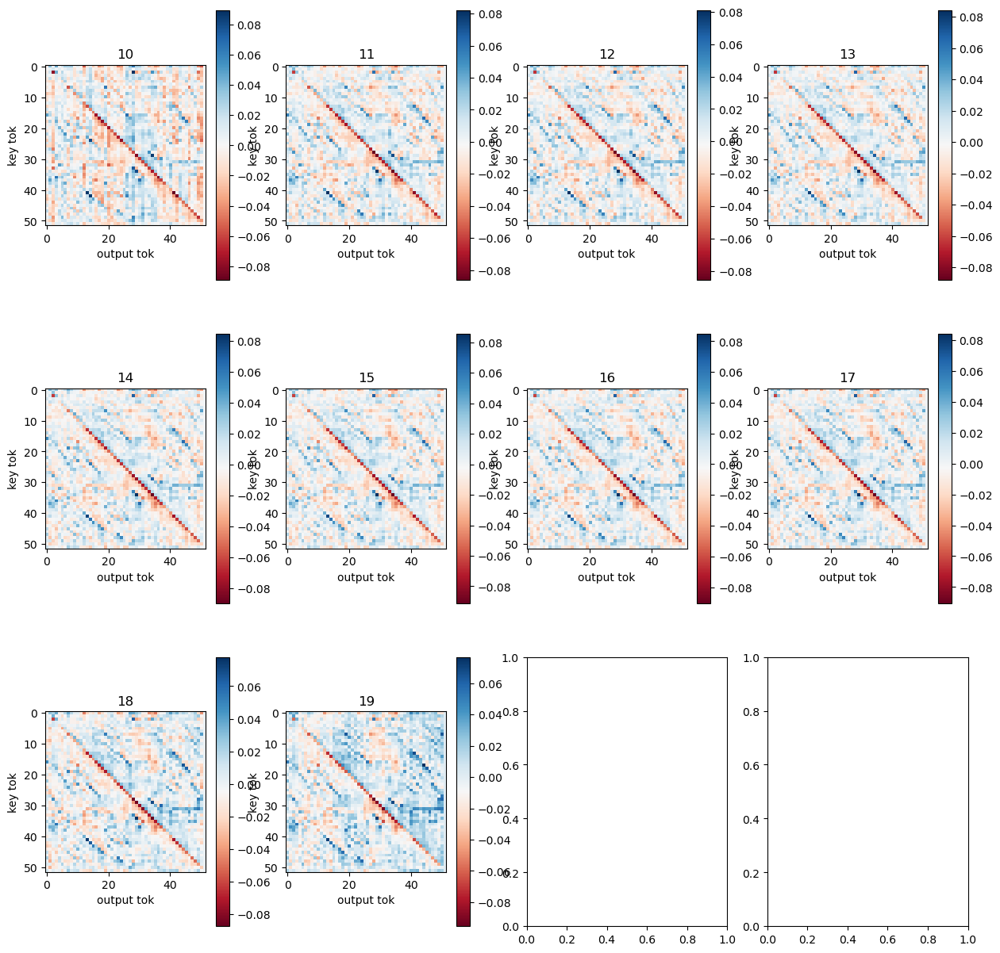

In [ ]:
# Here you may want to determine an appropriate grid size based on the number of plots
# For example, if you have a total of 12 plots, you might choose a 3x4 grid
n_rows = 3  # Example value, adjust as needed
n_cols = 4  # Example value, adjust as needed

# Create a figure and a grid of subplots
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))

# Flatten the 2D axis array to easily iterate over it in a single loop
ax = ax.flatten()

# Counter for the subplot index
plot_idx = 0

for pos in range(dataset.list_len, dataset.seq_len-1):
    EUPU = ln_final_noscale(model.W_pos[pos,:] + model.W_E) @ model.W_U
    EUPU = EUPU.detach().cpu().numpy()
    # Check if the counter exceeds the available subplots and create new figure if needed
    if plot_idx >= n_rows * n_cols:
        fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
        ax = ax.flatten()
        plot_idx = 0

    # Plot heatmap
    cax = ax[plot_idx].imshow(EUPU, cmap='RdBu')

    # Set title and axis labels if desired

    ax[plot_idx].set_title(f"{pos}")
    ax[plot_idx].set_xlabel("output tok")
    ax[plot_idx].set_ylabel("key tok")

    # Optionally add a colorbar
    plt.colorbar(cax, ax=ax[plot_idx])

    # Increment the counter
    plot_idx += 1

    # You might want to save or display the plot here if you're iterating over many subplots
    if plot_idx == 0:
        plt.tight_layout()
        plt.show()

In [15]:
attn_all = compute_attn_all(model, outdim='h qpos kpos qtok ktok')

In [21]:
analyze_svd(attn_all[1,10,0])

In [36]:
s = layernorm_scales(model.W_pos[:,None,:] + model.W_E[None,:,:])[...,0]
s = s / s.min()
imshow(s)
# resid = model.blocks[0].ln1(model.W_pos[:,None,:] + model.W_E[None,:,:])
# q_all = einsum(resid,
#                    model.W_Q[0,:,:,:],
#                    'qpos qtok d_model_q, h d_model_q d_head -> qpos qtok h d_head') + model.b_Q[0]
#     k_all = einsum(resid,
#                    model.W_K[0,:,:,:],
#                    'kpos ktok d_model_k, h d_model_k d_head -> kpos ktok h d_head') + model.b_K[0]
#     attn_all = einsum(q_all, k_all, f'qpos qtok h d_head, kpos ktok h d_head -> {outdim}')
#     attn_all_max = reduce(attn_all, f"{outdim} -> {outdim.replace('kpos', '()').replace('ktok', '()')}", 'max')


In [ ]:



x = x - x.mean(axis=-1, keepdim=True)  # [batch, pos, length]
        scale: Float[torch.Tensor, "batch pos 1"] = self.hook_scale(
            (x.pow(2).mean(-1, keepdim=True) + self.eps).sqrt()
        )
        x = x / scale  # [batch, pos, length]

In [ ]:
model.blocks[0].ln1

LayerNorm(
  (hook_scale): HookPoint()
  (hook_normalized): HookPoint()
)

In [ ]:
sys.path.append(f"{os.getcwd()}/training")
import visualization
from visualization import visualize_on_input

In [ ]:
dataset.toks[0]

tensor([ 7,  5, 47, 20, 48, 24, 11,  4, 19, 39, 51,  4,  5,  7, 11, 19, 20, 24,
        39, 47, 48])

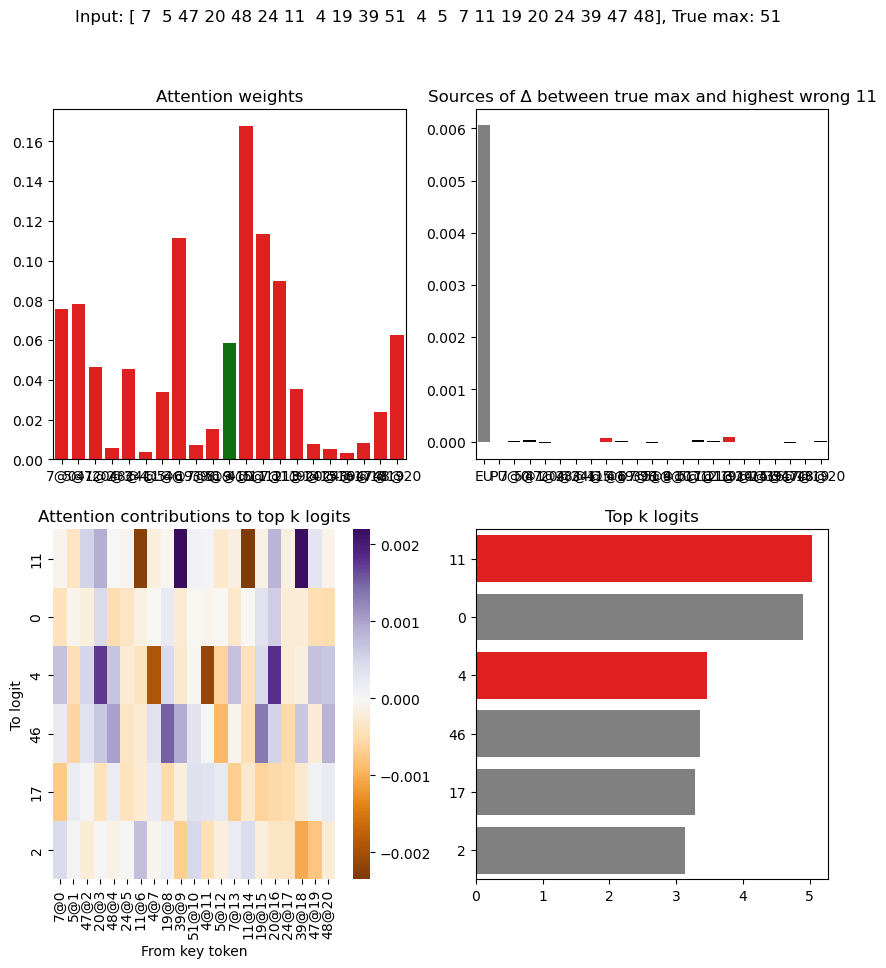

In [ ]:
visualize_on_input(model, dataset.toks[0])

In [ ]:
targets[326]

tensor([ 5,  7, 34, 37, 38, 40, 43, 46, 47, 48])

In [ ]:
' '.join(dataset.str_toks[326])

'46 48 34 7 37 5 40 38 47 43 SEP 5 7 34 37 38 40 43 46 47 48'

In [ ]:

imshow(logits[326])

In [ ]:
ls = [5,6,33,40,41,42,43,44,45,46]
# ls = [1, 1, 1, 1, 40, 40, 40, 40, 40]
unsorted_list = t.tensor(ls)
sorted_list = t.sort(unsorted_list).values
toks = t.concat([unsorted_list, t.tensor([dataset.vocab.index("SEP")]), sorted_list], dim=-1)
str_toks = [dataset.vocab[i] for i in toks]
print(' '.join(str_toks))
imshow(model(toks.unsqueeze(0))[0, dataset.list_len:-1, :])

5 6 33 40 41 42 43 44 45 46 SEP 5 6 33 40 41 42 43 44 45 46


In [ ]:
probs_correct.min(dim=0,keepdim=True)


torch.return_types.min(
values=tensor([[8.3706e-01, 6.7002e-02, 8.9708e-04, 7.4661e-01, 4.5623e-01, 4.9149e-02,
         2.1312e-01, 1.7685e-01, 6.0897e-01, 9.1048e-01]], device='cuda:0',
       grad_fn=<MinBackward0>),
indices=tensor([[210,  51, 326, 236, 441, 450, 370,  67, 110, 425]], device='cuda:0'))

In [ ]:
logits, cache = model.run_with_cache(dataset.toks)
logits: t.Tensor = logits[:, dataset.list_len:-1, :]

targets = dataset.toks[:, dataset.list_len+1:]

logprobs = logits.log_softmax(-1) # [batch seq_len vocab_out]
probs = logprobs.softmax(-1)


In [ ]:
model.W_pos.shape

torch.Size([21, 96])

In [ ]:
model.W_E.shape

torch.Size([52, 96])

In [ ]:
from einops import reduce

In [ ]:
W_pos_reduced = model.W_pos[dataset.list_len+1:-1]
W_pos_mean = W_pos_reduced.mean(dim=0)
W_pos_centered = W_pos_reduced - W_pos_mean[None,:]
line(W_pos_mean)
imshow(W_pos_centered)

In [ ]:
U, S, Vh = t.svd(model.W_pos.detach().cpu()[:10])
imshow(U)
imshow(Vh)
line(S)
U, S, Vh = t.svd(model.W_pos.detach().cpu()[11:])
imshow(U)
imshow(Vh)
line(S)

In [ ]:
with t.no_grad():
    # print((model.blocks[0].ln1(model.W_pos[dataset.list_len:-1,None,:] + model.W_E[None,:,:])).shape)
    # print(model.W_Q[0,:,:,:].shape)
    # print(model.W_K[0,:,:,:].shape)
    attn_all = einsum(model.blocks[0].ln1(model.W_pos[dataset.list_len:-1,None,:] + model.W_E[None,:,:]),
                      model.W_Q[0,:,:,:],
                      model.W_K[0,:,:,:],
                      model.blocks[0].ln1(model.W_pos[:-1,None,:] + model.W_E[None,:,:]),
                   'qpos qtok d_model_q, h d_model_q d_head, h d_model_k d_head, kpos ktok d_model_k -> h qpos kpos qtok ktok')
    # for h in range(2):
    #     for qpos in range(attn_all.shape[1]):
    #         for qtok in range(attn_all.shape[3]):
    #             attn_all[h,qpos,:,qtok,:] = attn_all[h,qpos,:,qtok,:] - attn_all[h,qpos,:,qtok,:].max()
    # attn_all = attn_all - attn_all.max(dim=2, keepdim=True).values
    print(attn_all.shape)
    attn_all_reduced = attn_all.clone()
    for qpos in range(attn_all.shape[1]):
        attn_all_reduced[:,qpos,:,:] = attn_all[:,qpos,:qpos+11,:].mean(dim=1, keepdim=True)
    attn_all_reduced = attn_all_reduced.mean(dim=2)[:,1:-1].mean(dim=1)
    print(attn_all_reduced.shape)
    # subtract off diagonal
    for h in range(attn_all_reduced.shape[0]):
        attn_all_reduced[h] = attn_all_reduced[h] - attn_all_reduced[h].diag()[:, None]
    attn_all_reduced = attn_all_reduced - attn_all_reduced.max(dim=-1,keepdim=True).values
    # attn_all_reduced = attn_all_reduced - attn_all_reduced.max(dim=-1, keepdim=True).values
    for h, attn in enumerate(attn_all_reduced):
        imshow(attn, title=f"h{h} attn_all_reduced")
    for h, attn in enumerate(attn_all_reduced):
        U, S, Vh = t.svd(attn)
        imshow(U, title=f"h{h} U attn_all_reduced")
        imshow(Vh, title=f"h{h} Vh attn_all_reduced")
        line(S, title=f"h{h} S attn_all_reduced")

    # print(attn_all_reduced.shape)

    # attn_all_reduced = attn_all[:,].mean(dim=1)
    # attn_all_reduced = reduce(attn_all[:,], 'h qpos kpos qtok ktok -> h qpos kpos qtok', 'sum')
    # all_attn_by_gap = []
    # #t.zeros(list(attn_all.shape[:-1]) + [attn_all.shape[-1], attn_all.shape[-1]])
    # for h in range(2):
    #     for qpos in range(attn_all.shape[1]):
    #         for kpos in range(qpos+1):
    #             for qtok in range(attn_all.shape[3]):
    #                 for ktok1 in range(attn_all.shape[4]):
    #                     for ktok2 in range(attn_all.shape[4]):
    #                         all_attn_by_gap.append(attn_all[h,qpos,kpos,qtok,ktok])

torch.Size([2, 10, 20, 52, 52])
torch.Size([2, 52, 52])


In [ ]:
model.blocks[0].ln1(model.W_pos[qpos,:] + model.W_E) @ model.W_Q[0,h,:,:] @ model.W_K[0,h,:,:].T @ model.blocks[0].ln1(model.W_pos[kpos,:] + model.W_E).T

In [ ]:
attn = model.blocks[0].ln1(model.W_pos[qpos,:] + model.W_E) @ model.W_Q[0,h,:,:] @ model.W_K[0,h,:,:].T @ model.blocks[0].ln1(model.W_pos[kpos,:] + model.W_E).T
            attn = attn - attn.max(dim=-1, keepdim=True).values
            attn = attn.detach().cpu().numpy()


In [ ]:
# with t.no_grad():
#     attn_all = einsum(model.blocks[0].ln1(model.W_pos[dataset.list_len:-1,None,:] + model.W_E[None,:,:]),
#                       model.W_Q[0,:,:,:],
#                       model.W_K[0,:,:,:],
#                       model.blocks[0].ln1(model.W_pos[:-1,None,:] + model.W_E[None,:,:]),
#                    'qpos qtok d_model_q, h d_model_q d_head, h d_model_k d_head, kpos ktok d_model_k -> h qpos kpos qtok ktok')


In [ ]:
model.W_O.shape

torch.Size([1, 2, 48, 96])

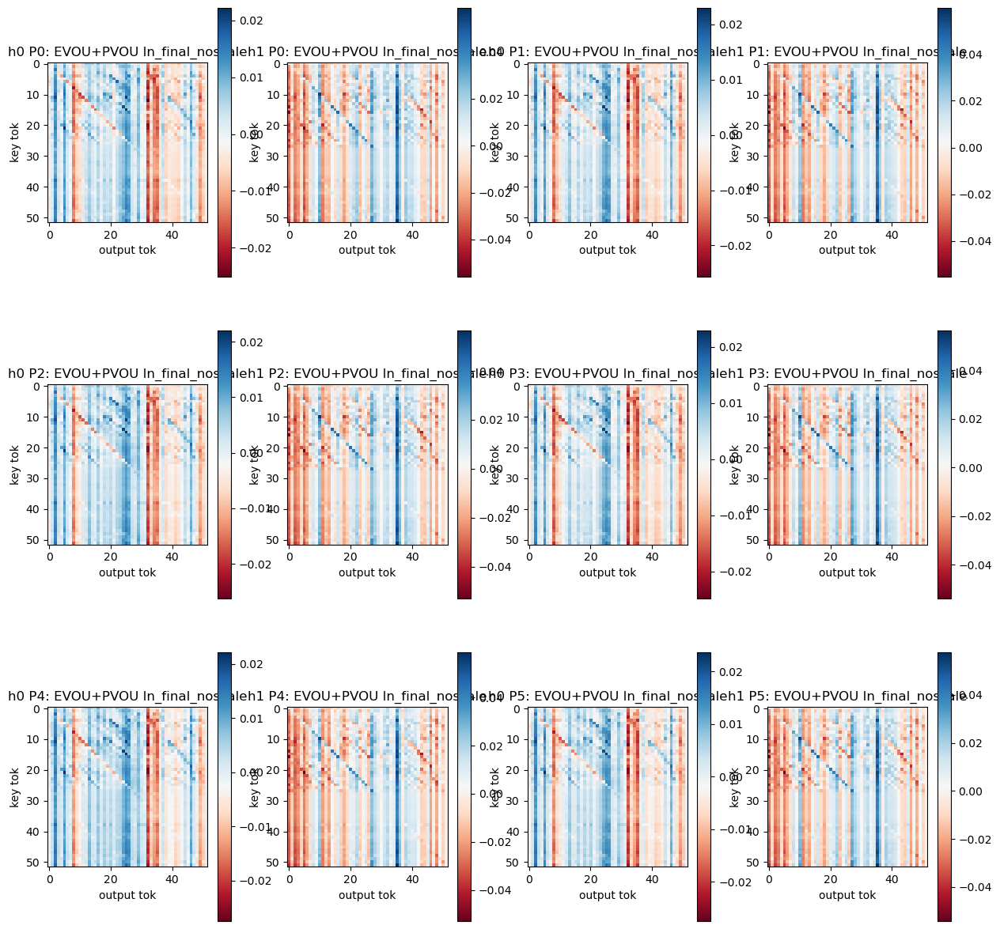

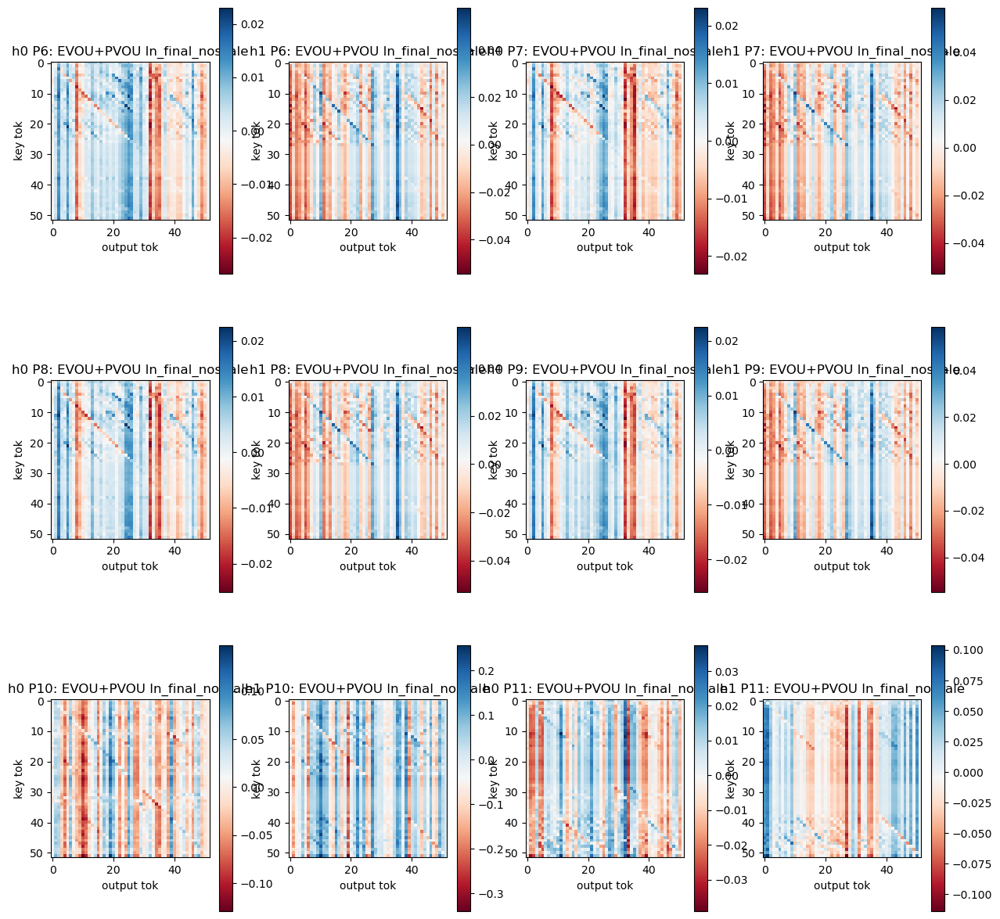

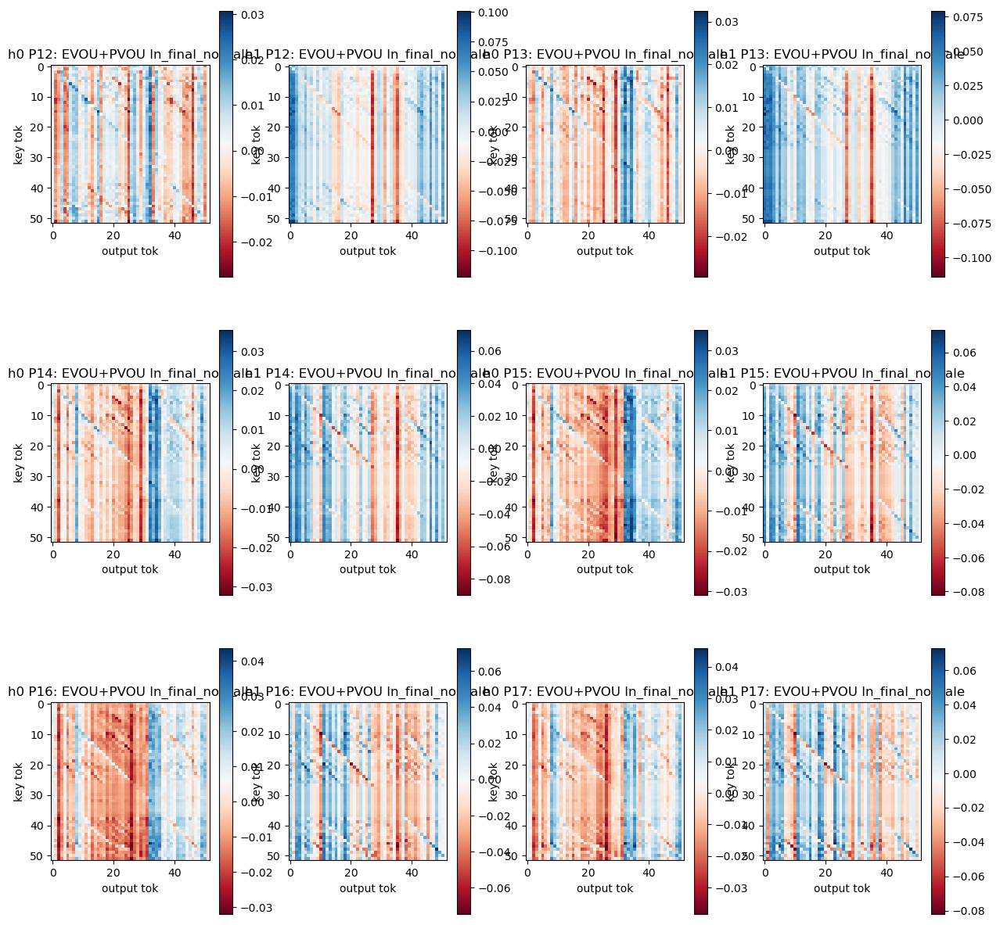

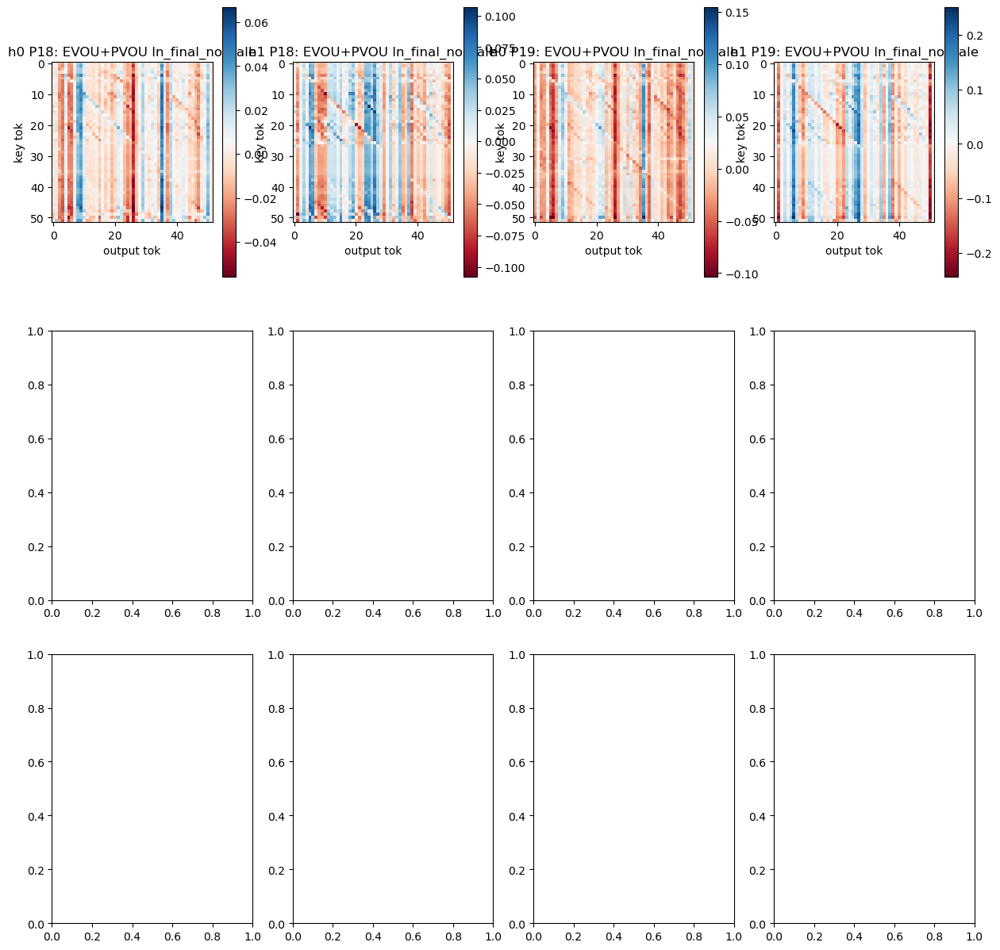

In [ ]:
with t.no_grad():
    EP = model.W_pos[:-1,None,:] + model.W_E[None,:,:]
    EP = model.blocks[0].ln1(EP)
    EPVO =  einsum(EP,
                   model.W_V[0,:,:,:],
                   model.W_O[0,:,:,:],
                   '''pos vocab_in d_model_v,
                    h d_model_v d_head,
                    h d_head d_model_o
                      -> h pos vocab_in d_model_o'''.replace('\n', ' '))
    EPVO = ln_final_noscale(EPVO)
    EPVOU = einsum(EPVO,
                     model.W_U,
                     '''h pos vocab_in d_model_o,
                     d_model_o vocab_out
                     -> h pos vocab_in vocab_out'''.replace('\n', ' '))
    EPVOU_mean = t.cat([EPVOU[:,:dataset.list_len,:,:], EPVOU[:,dataset.list_len+1:-1,:,:]], dim=1).mean(dim=1,keepdim=True)
    EPVOU = EPVOU - EPVOU_mean
    # EPVOU_mean = EPVOU_mean - EPVOU_mean.max(dim=-1, keepdim=True).values
    for h in range(2):
        imshow(EPVOU_mean[h, 0], title=f"h{h} EPVOU.mean(dim=pos)")

    for h in range(2):
        line(EPVOU_mean[h, 0].diag(), title=f"h{h} EPVOU.mean(dim=pos).diag()")
    line(EPVOU_mean[:, 0].sum(dim=0).diag(), title=f"h{h} EPVOU.mean(dim=pos).sum(dim=head).diag()")
    # Here you may want to determine an appropriate grid size based on the number of plots
    # For example, if you have a total of 12 plots, you might choose a 3x4 grid
    n_rows = 3  # Example value, adjust as needed
    n_cols = 4  # Example value, adjust as needed

    # Create a figure and a grid of subplots
    fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))

    # Flatten the 2D axis array to easily iterate over it in a single loop
    ax = ax.flatten()

    # Counter for the subplot index
    plot_idx = 0

    for pos in range(EPVOU.shape[1]):
        for h in range(2):
            # Check if the counter exceeds the available subplots and create new figure if needed
            if plot_idx >= n_rows * n_cols:
                fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 15))
                ax = ax.flatten()
                plot_idx = 0

            # Plot heatmap
            cax = ax[plot_idx].imshow(EPVOU[h, pos].detach().cpu().numpy(), cmap='RdBu')

            # Set title and axis labels if desired

            ax[plot_idx].set_title(f"h{h} P{pos}: EVOU+PVOU ln_final_noscale")
            ax[plot_idx].set_xlabel("output tok")
            ax[plot_idx].set_ylabel("key tok")

            # Optionally add a colorbar
            plt.colorbar(cax, ax=ax[plot_idx])

            # Increment the counter
            plot_idx += 1

            # You might want to save or display the plot here if you're iterating over many subplots
            if plot_idx == 0:
                plt.tight_layout()
                plt.show()
    # for pos in range(EPVOU.shape[1]):
    #     for h in range(2):
    #         imshow(EPVOU[h, pos], title=f"h{h} pos{pos} EPVOU")
    #     break
    # EPVOU_all = einsum()
# for pos in range(dataset.seq_len-1):
#     for h in range(2):
#         EPVOU = ln_final_noscale(model.blocks[0].ln1(model.W_pos[qpos,:] + model.W_E) @ model.W_V[0,h,:,:] @ model.W_O[0,h,:,:]) @ model.W_U
#         EPVOU = EPVOU.detach().cpu().numpy()


In [ ]:
model.b_K

tensor([[[-5.9785e-03,  5.8910e-03,  2.1748e-02, -2.9905e-03, -1.6389e-02,
           1.0764e-02, -9.0668e-03,  8.1832e-03, -7.8499e-03,  5.0168e-03,
           5.6709e-04, -1.2493e-02,  1.2560e-02, -3.8263e-03,  2.3874e-02,
           7.8742e-03, -1.1553e-02,  5.2587e-03, -9.3646e-04,  1.0724e-02,
          -2.8640e-02, -1.7078e-02, -2.4393e-02,  1.9902e-02,  6.7293e-03,
           1.0139e-02, -2.6819e-02, -7.9144e-03,  9.0924e-04, -2.0032e-03,
           1.5646e-02, -1.5148e-02,  4.7740e-03, -2.3489e-03,  2.4529e-02,
          -1.5721e-02, -2.9137e-03,  2.0364e-05,  1.7612e-02,  2.1432e-02,
          -2.9528e-03, -7.0996e-03,  3.3721e-03,  1.4056e-02, -6.6414e-03,
           4.7391e-03, -6.8595e-05, -6.2641e-03],
         [-6.6149e-03, -8.1851e-03,  1.1973e-02, -1.5781e-02,  7.0602e-03,
          -6.5213e-03,  8.3500e-04, -3.9705e-03, -3.3419e-03, -1.2252e-02,
           1.7027e-02,  4.3331e-03, -4.7513e-04, -3.6890e-03,  3.7132e-03,
           3.4128e-03,  4.4706e-04, -1.9793e-03, -